# Benchmark splicing from DNA LM interactions

In [1]:
import pandas as pd 
import pyranges as pr
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import convolve2d
import math
import torch
from collections import OrderedDict
from plotnine import *
import gzip
import shutil

In [2]:
data_path = 'data'

In [3]:
os.chdir(os.path.join(project_path, 'dna-lm-interactions-paper/code_submission'))
from utils import create_load_matrix_function, plot_matrix_with_roi, plot_weights, plot_ci_matrix
from model_wrappers import ReconstructionModel

/opt/modules/i12g/anaconda/envs/flash2/lib/python3.8/site-packages/torch/amp/autocast_mode.py:202: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling


In [4]:
species_of_interest = 'saccharomyces_cerevisiae'
get_ci_matrix = create_load_matrix_function(species_of_interest)

Loading dataframes with snp preds...


In [5]:
pr.__version__ # some pyranges versions have a problem getting the reverse complemment sequence right, ex. 0.0.127 does not have a problem. Others might retrieve the seqeunce as is without reverse complemmenting it

'0.0.127'

## S. Cerevisiae

In [ ]:
import glob

def get_species_gtf_fasta_files(species_of_interest, file_type):

    species_folders = glob.glob(os.path.join(sequences_path, f'{file_type}/**/{species_of_interest}'), recursive=True)
    
    assert len(species_folders) == 1
    species_folder = species_folders[0]

    pattern = os.path.join(species_folder, '**', 'dna', '*dna.toplevel.fa.gz') if file_type == 'fasta' else os.path.join(species_folder, '**', '*.gtf.gz')
    files = glob.glob(pattern, recursive=True)
    if len(files) > 1:
        if file_type == 'fasta':
            print(f'multiple fasta files found: {files}')
        else:
            for file in files:
                if 'chr' in file.split('.')[-3]:
                    #remove file from list
                    files.remove(file)
            if len(files) > 1:
                print(f'multiple gtf files found even after filtering for chr: {files}')

    print(files[0])
    return files[0]


In [5]:
species_of_interest = 'saccharomyces_cerevisiae'
fasta_path = get_species_gtf_fasta_files(species_of_interest, 'fasta')
gtf_path = get_species_gtf_fasta_files(species_of_interest, 'gtf')

/s/project/semi_supervised_multispecies/Downstream/Sequences/ensembl_53/fasta/saccharomyces_cerevisiae/dna/Saccharomyces_cerevisiae.R64-1-1.dna.toplevel.fa.gz
/s/project/semi_supervised_multispecies/Downstream/Sequences/ensembl_53/gtf/saccharomyces_cerevisiae/Saccharomyces_cerevisiae.R64-1-1.53.gtf.gz


In [6]:
# load the dataframes
snp_df = pd.read_parquet(f"/data/ceph/hdd/project/node_09/semi_supervised_multispecies/Downstream/PipelineOutputs/samples_upstream_kazachstania_k1_interaction/{species_of_interest}/snp.parquet").reset_index()
id_to_path = pd.read_parquet(f"/data/ceph/hdd/project/node_09/semi_supervised_multispecies/Downstream/PipelineOutputs/samples_upstream_kazachstania_k1_interaction/{species_of_interest}/id_to_path.parquet")
snp_df = id_to_path.merge(snp_df, on="transcript_id")

snp_df = snp_df.reset_index(drop=True) # make sure the index is unique
assert (snp_df.index == snp_df["index"]).all() # check that the index is unique


all_genes = snp_df['gene_id'].unique() # In pandas Uniques are returned in order of appearance. That is important later on to optimize reading files


gene_to_idxs_snps_dataframe = snp_df.groupby('gene_id').groups # create a dictionary mapping gene_id to indices in the snp_df dataframe for very fast lookup increases speed by at least 10x
transcripts_to_idxs_snps_dataframe = snp_df.groupby('transcript_id').groups
file_cache = OrderedDict()
CACHE_SIZE = 10 



def get_ci_matrix(gene_id=None, transcript_id=None, effect_on_ref_only=False, use_logit=True, eps=1e-10):
    
    global file_cache
    if transcript_id is None: 
        if gene_id not in gene_to_idxs_snps_dataframe:
            return None
        snp_subset_df = snp_df.loc[gene_to_idxs_snps_dataframe[gene_id]] 
    elif transcript_id not in transcripts_to_idxs_snps_dataframe:
            return None
    else:
        snp_subset_df = snp_df.loc[transcripts_to_idxs_snps_dataframe[transcript_id]] 

    if len(snp_subset_df) == 0:
        return None
    # get path and indices
    path = snp_subset_df.iloc[0]["path"]
    offset = int(path.split("_")[-2])
    start = snp_subset_df["index"].min() - offset
    end = snp_subset_df["index"].max() - offset

    # load matrix
    if path in file_cache:
        # Move to the end to show that it was recently accessed
        file_cache.move_to_end(path)
        interact_mat = file_cache[path]
    else:
        interact_mat = torch.load(path)
        file_cache[path] = interact_mat
        # Remove the oldest item if cache exceeds its size limit
        if len(file_cache) > CACHE_SIZE:
            file_cache.popitem(last=False)

    interact_mat = interact_mat[start:end+1]
    interact_mat = interact_mat.float()

    if use_logit: # for the logit add the small value and renormalize such that every prob in one position sums to 1
        interact_mat = interact_mat + eps 
        interact_mat = interact_mat/interact_mat.sum(axis=-1,keepdim=True)

    # prepare snp effect matrix  
    interact_mat_ref = interact_mat[0]
    interact_mat_alt = interact_mat[1:]

    #return interact_mat_alt, interact_mat_ref
    if not use_logit:
        snp_effect_unordered = torch.log(interact_mat_alt + eps) - torch.log(interact_mat_ref + eps)#.unsqueeze(0)
    else:
        snp_effect_unordered = (torch.log(interact_mat_alt) - torch.log(1 - interact_mat_alt) 
                                - torch.log(interact_mat_ref) + torch.log(1 - interact_mat_ref))


    snp_effect = torch.zeros((4,1003,1003,4))

    snp_effect[snp_subset_df.iloc[1:]['var_nt_idx'].values, snp_subset_df.iloc[1:]['var_pos'].values] = snp_effect_unordered
    
    ci_matrix = torch.abs(snp_effect).max(dim=0)[0].max(dim=2)[0]

    return ci_matrix

In [7]:
gtf_pr = pr.read_gtf(gtf_path)
gtf_df = gtf_pr.df.copy()
gtf_df

,Chromosome,Source,Feature,Start,End,Score,Strand,Frame,gene_id,gene_name,gene_source,gene_biotype,transcript_id,transcript_name,transcript_source,transcript_biotype,exon_number,exon_id,protein_id
0,I,sgd,gene,74019,74823,.,+,.,YAL037W,NaN,sgd,protein_coding,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,I,sgd,transcript,74019,74823,.,+,.,YAL037W,NaN,sgd,protein_coding,YAL037W_mRNA,NaN,sgd,protein_coding,NaN,NaN,NaN
2,I,sgd,exon,74019,74823,.,+,.,YAL037W,NaN,sgd,protein_coding,YAL037W_mRNA,NaN,sgd,protein_coding,1,YAL037W_mRNA-E1,NaN
3,I,sgd,CDS,74019,74820,.,+,0,YAL037W,NaN,sgd,protein_coding,YAL037W_mRNA,NaN,sgd,protein_coding,1,NaN,YAL037W
4,I,sgd,start_codon,74019,74022,.,+,0,YAL037W,NaN,sgd,protein_coding,YAL037W_mRNA,NaN,sgd,protein_coding,1,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41874,XVI,sgd,transcript,437332,442742,.,-,.,YPL060C-A,NaN,sgd,transposable_element,YPL060C-A,NaN,sgd,transposable_element,NaN,NaN,NaN
41875,XVI,sgd,exon,437332,442742,.,-,.,YPL060C-A,NaN,sgd,transposable_element,YPL060C-A,NaN,sgd,transposable_element,1,YPL060C-A-E1,NaN
41876,XVI,sgd,gene,854934,856257,.,-,.,YPR158C-C,NaN,sgd,transposable_element,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41877,XVI,sgd,transcript,854934,856257,.,-,.,YPR158C-C,NaN,sgd,transposable_element,YPR158C-C,NaN,sgd,transposable_element,NaN,NaN,NaN


In [8]:
from torch.utils.data import Dataset, DataLoader

class GeneMatrix(Dataset):
    def __init__(self, gene_ids):
        """
        Args:
            gene_ids (list): List of gene IDs.
        """
        self.gene_ids = gene_ids

    def __len__(self):
        return len(self.gene_ids)

    def __getitem__(self, idx):
        gene_id = self.gene_ids[idx]
        ci_matrix = get_ci_matrix(gene_id).unsqueeze(0) #add a dimension for the channel

        return ci_matrix

In [10]:
dataset = GeneMatrix(all_genes)

batch_size = 16
data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

### Get the gtf annotated introns of each gene:

In [11]:
gtf_exons_df = gtf_df[(gtf_df.Feature == "exon")].copy()
gtf_exons_df

,Chromosome,Source,Feature,Start,End,Score,Strand,Frame,gene_id,gene_name,gene_source,gene_biotype,transcript_id,transcript_name,transcript_source,transcript_biotype,exon_number,exon_id,protein_id
2,I,sgd,exon,74019,74823,.,+,.,YAL037W,NaN,sgd,protein_coding,YAL037W_mRNA,NaN,sgd,protein_coding,1,YAL037W_mRNA-E1,NaN
8,I,sgd,exon,124878,126786,.,+,.,YAL016W,TPD3,sgd,protein_coding,YAL016W_mRNA,TPD3,sgd,protein_coding,1,YAL016W_mRNA-E1,NaN
14,I,sgd,exon,142173,142253,.,+,.,YAL003W,EFB1,sgd,protein_coding,YAL003W_mRNA,EFB1,sgd,protein_coding,1,YAL003W_mRNA-E1,NaN
17,I,sgd,exon,142619,143160,.,+,.,YAL003W,EFB1,sgd,protein_coding,YAL003W_mRNA,EFB1,sgd,protein_coding,2,YAL003W_mRNA-E2,NaN
22,I,sgd,exon,45898,48250,.,+,.,YAL053W,FLC2,sgd,protein_coding,YAL053W_mRNA,FLC2,sgd,protein_coding,1,YAL053W_mRNA-E1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41866,XVI,sgd,exon,850988,856257,.,-,.,YPR158C-D,NaN,sgd,transposable_element,YPR158C-D,NaN,sgd,transposable_element,1,YPR158C-D-E1,NaN
41869,XVI,sgd,exon,808946,810269,.,-,.,YPR137C-A,NaN,sgd,transposable_element,YPR137C-A,NaN,sgd,transposable_element,1,YPR137C-A-E1,NaN
41872,XVI,sgd,exon,805000,810269,.,-,.,YPR137C-B,NaN,sgd,transposable_element,YPR137C-B,NaN,sgd,transposable_element,1,YPR137C-B-E1,NaN
41875,XVI,sgd,exon,437332,442742,.,-,.,YPL060C-A,NaN,sgd,transposable_element,YPL060C-A,NaN,sgd,transposable_element,1,YPL060C-A-E1,NaN


In [12]:
gtf_df.Feature.unique() #gtf doesn't have an intron feature, we will have to extract it from the exon annotations

['gene', 'transcript', 'exon', 'CDS', 'start_codon', 'stop_codon', 'five_prime_utr']
Categories (7, object): ['CDS', 'exon', 'five_prime_utr', 'gene', 'start_codon', 'stop_codon', 'transcript']

In [13]:
#For every gene we get the start and end coordinates and get the gaps between the exons as coordinates for introns
def get_introns(gene_df):
    
    gene_pr = pr.PyRanges(gene_df)
    gene = gene_pr.gene_id.unique()[0]
    print(gene)
    
    #Get boundaries of the whole gene defined by the exon
    #Pyranges boundaries returns them as float (very annoying bug) where they should be int. 
    #Converting them back to df and then to pyranges solves it ;)
    gene_boundaries_pr = pr.PyRanges(gene_pr.boundaries(group_by='Feature').df)

    introns_df = gene_boundaries_pr.subtract(gene_pr).df #get introns
    introns_df['Feature'] = 'intron'
    
    return introns_df

In [14]:
gtf_introns_df = gtf_exons_df.groupby('gene_id').apply(get_introns)
gtf_introns_df = gtf_introns_df.droplevel(1).reset_index()
gtf_introns_df

ETS1-1
ETS1-2
ETS2-1
ETS2-2
HRA1
ICR1
IRT1
ITS1-1
ITS1-2
ITS2-1
ITS2-2
LSR1
NME1
PWR1
Q0010
Q0017
Q0020
Q0032
Q0045
Q0050
Q0055
Q0060
Q0065
Q0070
Q0075
Q0080
Q0085
Q0092
Q0105
Q0110
Q0115
Q0120
Q0130
Q0140
Q0142
Q0143
Q0144
Q0158
Q0160
Q0182
Q0250
Q0255
Q0275
Q0285
Q0297
RDN18-1
RDN18-2
RDN25-1
RDN25-2
RDN37-1
RDN37-2
RDN5-1
RDN5-2
RDN5-3
RDN5-4
RDN5-5
RDN5-6
RDN58-1
RDN58-2
RME2
RME3
RNA170
RPR1
RUF20
RUF21
RUF22
RUF23
RUF5-1
RUF5-2
SCR1
SRG1
YAL001C
YAL002W
YAL003W
YAL004W
YAL005C
YAL007C
YAL008W
YAL009W
YAL010C
YAL011W
YAL012W
YAL013W
YAL014C
YAL015C
YAL016C-A
YAL016C-B
YAL016W
YAL017W
YAL018C
YAL019W
YAL019W-A
YAL020C
YAL021C
YAL022C
YAL023C
YAL024C
YAL025C
YAL026C
YAL026C-A
YAL027W
YAL028W
YAL029C
YAL030W
YAL031C
YAL031W-A
YAL032C
YAL033W
YAL034C
YAL034C-B
YAL034W-A
YAL035W
YAL036C
YAL037C-A
YAL037C-B
YAL037W
YAL038W
YAL039C
YAL040C
YAL041W
YAL042C-A
YAL042W
YAL043C
YAL044C
YAL044W-A
YAL045C
YAL046C
YAL047C
YAL047W-A
YAL048C
YAL049C
YAL051W
YAL053W
YAL054C
YAL055W
YAL056C-A
YAL056

,gene_id,Feature,Chromosome,Start,End,Strand
0,Q0045,intron,Mito,13986.0,16434.0,+
1,Q0045,intron,Mito,16470.0,18953.0,+
2,Q0045,intron,Mito,18991.0,20507.0,+
3,Q0045,intron,Mito,20984.0,21994.0,+
4,Q0045,intron,Mito,22246.0,23611.0,+
...,...,...,...,...,...,...
375,tY(GUA)J1,intron,X,354282.0,354296.0,+
376,tY(GUA)J2,intron,X,542991.0,543005.0,-
377,tY(GUA)M1,intron,XIII,168833.0,168847.0,+
378,tY(GUA)M2,intron,XIII,837966.0,837980.0,+


In [15]:
def get_donor_acceptor_sites(intron, donor_length=5, acceptor_length=2): #donor length is 5 in cerevisiae
    if intron.Strand == "+":
        return pd.Series({"donor_start": intron.Start, "donor_end": intron.Start+donor_length, "acceptor_start": intron.End-acceptor_length, "acceptor_end": intron.End})
    elif intron.Strand == "-":
        return pd.Series({"donor_start": intron.End-donor_length, "donor_end": intron.End, "acceptor_start": intron.Start, "acceptor_end": intron.Start+acceptor_length})
    else:
        raise ValueError("Strand must be + or -")

In [16]:
donor_acceptor_df = gtf_introns_df.apply(get_donor_acceptor_sites, axis=1)
assert donor_acceptor_df.shape[0] == gtf_introns_df.shape[0]
gtf_introns_df = pd.concat([gtf_introns_df, donor_acceptor_df], axis=1)
gtf_introns_df.rename(columns={'Start': 'intron_start', 'End': 'intron_end'}, inplace=True)
gtf_introns_df

,gene_id,Feature,Chromosome,intron_start,intron_end,Strand,donor_start,donor_end,acceptor_start,acceptor_end
0,Q0045,intron,Mito,13986.0,16434.0,+,13986.0,13991.0,16432.0,16434.0
1,Q0045,intron,Mito,16470.0,18953.0,+,16470.0,16475.0,18951.0,18953.0
2,Q0045,intron,Mito,18991.0,20507.0,+,18991.0,18996.0,20505.0,20507.0
3,Q0045,intron,Mito,20984.0,21994.0,+,20984.0,20989.0,21992.0,21994.0
4,Q0045,intron,Mito,22246.0,23611.0,+,22246.0,22251.0,23609.0,23611.0
...,...,...,...,...,...,...,...,...,...,...
375,tY(GUA)J1,intron,X,354282.0,354296.0,+,354282.0,354287.0,354294.0,354296.0
376,tY(GUA)J2,intron,X,542991.0,543005.0,-,543000.0,543005.0,542991.0,542993.0
377,tY(GUA)M1,intron,XIII,168833.0,168847.0,+,168833.0,168838.0,168845.0,168847.0
378,tY(GUA)M2,intron,XIII,837966.0,837980.0,+,837966.0,837971.0,837978.0,837980.0


In [17]:
#Here we get the donor and acceptor sequences from a zipped fasta file
#unzip the fasta file in the current directory and read the file

temp_unzipped_fasta_path = f'{species_of_interest}_temp.fa'
with gzip.open(fasta_path, 'rb') as f_in:
    with open(temp_unzipped_fasta_path, 'wb') as f_out:
        shutil.copyfileobj(f_in, f_out)


introns_pr = pr.PyRanges(gtf_introns_df.rename(columns={'donor_start': 'Start', 'donor_end': 'End'}))
introns_pr.donor_seq = pr.get_sequence(introns_pr, path=temp_unzipped_fasta_path)
introns_pr = introns_pr.df.rename(columns={'Start': 'donor_start', 'End': 'donor_end'}).copy()

introns_pr = pr.PyRanges(introns_pr.rename(columns={'acceptor_start': 'Start', 'acceptor_end': 'End'}))
introns_pr.acceptor_seq = pr.get_sequence(introns_pr, path=temp_unzipped_fasta_path)
introns_df = introns_pr.df.rename(columns={'Start': 'acceptor_start', 'End': 'acceptor_end'}).copy()


#remove the unzipped fasta file
if os.path.exists(temp_unzipped_fasta_path):
    os.remove(temp_unzipped_fasta_path)

In [18]:
introns_df

,gene_id,Feature,Chromosome,intron_start,intron_end,Strand,donor_start,donor_end,acceptor_start,acceptor_end,donor_seq,acceptor_seq
0,YAL003W,intron,I,142253.0,142619.0,+,142253,142258,142617,142619,GTATG,AG
1,YAL030W,intron,I,87387.0,87500.0,+,87387,87392,87498,87500,GTAAG,AG
2,tL(CAA)A,intron,I,181178.0,181210.0,+,181178,181183,181208,181210,AAATA,TA
3,tP(UGG)A,intron,I,139187.0,139218.0,+,139187,139192,139216,139218,CGACT,CA
4,YAL001C,intron,I,151006.0,151096.0,-,151091,151096,151006,151008,GTATG,AG
...,...,...,...,...,...,...,...,...,...,...,...,...
375,snR17b,intron,XVI,281373.0,281503.0,-,281498,281503,281373,281375,GTATG,AG
376,tF(GAA)P1,intron,XVI,560233.0,560252.0,-,560247,560252,560233,560235,AAAAA,TT
377,tF(GAA)P2,intron,XVI,622575.0,622594.0,-,622589,622594,622575,622577,AAAAA,TT
378,tK(UUU)P,intron,XVI,769242.0,769265.0,-,769260,769265,769242,769244,AGCGC,AT


In [19]:
# check if donor and acceptor splice sites are present in the intron sequence

'''
#when pyranges does not look at the strand, default behaviour of version 0.0.129
def check_donor_seq(row):
    if row.Strand == '+':
        return row.donor_seq == 'GT' 
    elif row.Strand == '-':
        return row.donor_seq == 'AC' 
    else:
        raise ValueError('Unrecognized strand')

    
def check_acceptor_seq(row):
    if row.Strand == '+':
        return row.acceptor_seq == 'AG' 
    elif row.Strand == '-':
        return row.acceptor_seq == 'CT' 
    else:
        raise ValueError('Unrecognized strand')
'''

def check_donor_seq(row):
    return row.donor_seq[:2] == 'GT' 

    
def check_acceptor_seq(row):
    return row.acceptor_seq == 'AG' 

introns_df['donor_seq_present'] = introns_df.apply(check_donor_seq, axis=1)
introns_df['acceptor_seq_present'] = introns_df.apply(check_acceptor_seq, axis=1)
introns_df['canonical_sites'] = introns_df['donor_seq_present'] & introns_df['acceptor_seq_present']
introns_df.rename(columns={'gene_id': 'intron_gene_id'}, inplace=True)

In [20]:
introns_df['canonical_sites'].value_counts()

True     272
False    108
Name: canonical_sites, dtype: int64

most splice sites are canonical

In [21]:
introns_df[introns_df['canonical_sites']==False].iloc[:50]

,intron_gene_id,Feature,Chromosome,intron_start,intron_end,Strand,donor_start,donor_end,acceptor_start,acceptor_end,donor_seq,acceptor_seq,donor_seq_present,acceptor_seq_present,canonical_sites
2,tL(CAA)A,intron,I,181178.0,181210.0,+,181178,181183,181208,181210,AAATA,TA,False,False,False
3,tP(UGG)A,intron,I,139187.0,139218.0,+,139187,139192,139216,139218,CGACT,CA,False,False,False
18,tF(GAA)B,intron,II,36434.0,36452.0,+,36434,36439,36450,36452,AAAAA,TC,False,False,False
24,YBL111C,intron,II,4116.0,4215.0,-,4210,4215,4116,4118,GCATG,AG,False,True,False
37,tL(CAA)C,intron,III,90896.0,90928.0,+,90896,90901,90926,90928,AAATA,TA,False,False,False
38,tS(CGA)C,intron,III,227978.0,227997.0,+,227978,227983,227995,227997,TGGAA,CT,False,False,False
60,tI(UAU)D,intron,IV,884397.0,884457.0,+,884397,884402,884455,884457,GCAAC,CA,False,False,False
61,tK(UUU)D,intron,IV,359613.0,359636.0,+,359613,359618,359634,359636,AGCGC,AT,False,False,False
62,tY(GUA)D,intron,IV,946350.0,946364.0,+,946350,946355,946362,946364,TTTAT,AA,False,False,False
80,tF(GAA)D,intron,IV,1095405.0,1095424.0,-,1095419,1095424,1095405,1095407,AAAAA,AT,False,False,False


The non canonical splice sites seem to be mito and tRNAs

In [22]:
# Now let's get the start of the start codon for each gene
gtf_start_codons_df = gtf_df[gtf_df.Feature=='start_codon'].copy()

# the start codon is for some transcripts split in 2 parts because there is an intron in between. The DNA LM sees the upstream of both parts

def get_start_codon_start_id(row):
    if row['Strand'] == '+':
        return str(row['Start']) + '_' + row['transcript_id']
    else:
        return str(row['End']) + '_' + row['transcript_id']

gtf_start_codons_df['start_codon_start_id'] = gtf_start_codons_df.apply(get_start_codon_start_id, axis=1)
gtf_start_codons_df

,Chromosome,Source,Feature,Start,End,Score,Strand,Frame,gene_id,gene_name,gene_source,gene_biotype,transcript_id,transcript_name,transcript_source,transcript_biotype,exon_number,exon_id,protein_id,start_codon_start_id
4,I,sgd,start_codon,74019,74022,.,+,0,YAL037W,NaN,sgd,protein_coding,YAL037W_mRNA,NaN,sgd,protein_coding,1,NaN,NaN,74019_YAL037W_mRNA
10,I,sgd,start_codon,124878,124881,.,+,0,YAL016W,TPD3,sgd,protein_coding,YAL016W_mRNA,TPD3,sgd,protein_coding,1,NaN,NaN,124878_YAL016W_mRNA
16,I,sgd,start_codon,142173,142176,.,+,0,YAL003W,EFB1,sgd,protein_coding,YAL003W_mRNA,EFB1,sgd,protein_coding,1,NaN,NaN,142173_YAL003W_mRNA
24,I,sgd,start_codon,45898,45901,.,+,0,YAL053W,FLC2,sgd,protein_coding,YAL053W_mRNA,FLC2,sgd,protein_coding,1,NaN,NaN,45898_YAL053W_mRNA
30,I,sgd,start_codon,84668,84671,.,+,0,YAL031W-A,NaN,sgd,protein_coding,YAL031W-A_mRNA,NaN,sgd,protein_coding,1,NaN,NaN,84668_YAL031W-A_mRNA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41838,XVI,sgd,start_codon,172752,172755,.,-,0,YPL199C,NaN,sgd,protein_coding,YPL199C_mRNA,NaN,sgd,protein_coding,1,NaN,NaN,172755_YPL199C_mRNA
41844,XVI,sgd,start_codon,52668,52671,.,-,0,YPL259C,APM1,sgd,protein_coding,YPL259C_mRNA,APM1,sgd,protein_coding,1,NaN,NaN,52671_YPL259C_mRNA
41850,XVI,sgd,start_codon,895761,895764,.,-,0,YPR179C,HDA3,sgd,protein_coding,YPR179C_mRNA,HDA3,sgd,protein_coding,1,NaN,NaN,895764_YPR179C_mRNA
41856,XVI,sgd,start_codon,725141,725144,.,-,0,YPR096C,NaN,sgd,protein_coding,YPR096C_mRNA,NaN,sgd,protein_coding,1,NaN,NaN,725144_YPR096C_mRNA


In [23]:
gtf_start_codons_pr = pr.PyRanges(gtf_start_codons_df)
# check which introns overlap with start codon + 1000bp
#extend start codon by 1000bp
gtf_start_codons_pr = gtf_start_codons_pr.slack({"5": 1000})
gtf_introns_pr = pr.PyRanges(introns_df.rename(columns={'intron_start': 'Start', 'intron_end': 'End'}))

introns_overlapping_start_1000_pr = gtf_introns_pr.join(gtf_start_codons_pr, report_overlap=True, strandedness=False) #this introns overlap with the area 1000bp before a start codon, ignoring the strand
introns_overlapping_start_1000_pr

/opt/modules/i12g/anaconda/envs/fungi_code/lib/python3.8/site-packages/pyranges/tostring2.py:46: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.


,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,gene_biotype,transcript_id,transcript_name,transcript_source,transcript_biotype,exon_number,exon_id,protein_id,start_codon_start_id,Overlap
0,YAL003W,intron,I,142253,142619,+,142253,142258,142617,142619,...,protein_coding,YAL005C_mRNA,SSA1,sgd,protein_coding,1,NaN,NaN,141431_YAL005C_mRNA,178
1,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,protein_coding,YAL031C_mRNA,GIP4,sgd,protein_coding,1,NaN,NaN,87031_YAL031C_mRNA,113
2,tP(UGG)A,intron,I,139187,139218,+,139187,139192,139216,139218,...,protein_coding,YAL007C_mRNA,ERP2,sgd,protein_coding,1,NaN,NaN,138345_YAL007C_mRNA,31
3,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,protein_coding,YBL025W_mRNA,RRN10,sgd,protein_coding,1,NaN,NaN,171480_YBL025W_mRNA,128
4,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,protein_coding,YBL027W_mRNA,RPL19B,sgd,protein_coding,2,NaN,NaN,168808_YBL027W_mRNA,384
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,protein_coding,YPL110C_mRNA,GDE1,sgd,protein_coding,1,NaN,NaN,344739_YPL110C_mRNA,152
268,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,protein_coding,YPR064W_mRNA,NaN,sgd,protein_coding,1,NaN,NaN,678950_YPR064W_mRNA,86
269,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,protein_coding,YPR100W_mRNA,MRPL51,sgd,protein_coding,1,NaN,NaN,729790_YPR100W_mRNA,96
270,snR17b,intron,XVI,281373,281503,-,281498,281503,281373,281375,...,protein_coding,YPL143W_mRNA,RPL33A,sgd,protein_coding,1,NaN,NaN,282121_YPL143W_mRNA,130


In [24]:
# check if the introns fully overlap
introns_overlapping_start_1000_df = introns_overlapping_start_1000_pr.df
introns_overlapping_start_1000_df.rename(columns={'Start_b':'Start_start_codon', 'End_b':'End_start_codon', 'Strand_b': 'Strand_start_codon', 'gene_id':'gene_id_start_codon'}, inplace=True)
introns_overlapping_start_1000_df['intron_length'] = introns_overlapping_start_1000_df.End - introns_overlapping_start_1000_df.Start

In [25]:
#get start codon start coordinates back to the real start and not eh 1000bp before it
def correct_start_coordinates_plus_strand(row):
    if row.Strand_start_codon == '+':
        return row.Start_start_codon + 1000
    else:
        return row.Start_start_codon

def correct_start_coordinates_minus_strand(row):
    if row.Strand_start_codon == '-':
        return row.End_start_codon - 1000
    else:
        return row.End_start_codon
    

In [26]:
introns_overlapping_start_1000_df['Start_start_codon'] = introns_overlapping_start_1000_df.apply(correct_start_coordinates_plus_strand, axis=1)
introns_overlapping_start_1000_df['End_start_codon'] = introns_overlapping_start_1000_df.apply(correct_start_coordinates_minus_strand, axis=1)
introns_overlapping_start_1000_df['fully_overlaps'] = introns_overlapping_start_1000_df['intron_length'] == introns_overlapping_start_1000_df['Overlap']
introns_overlapping_start_1000_df = introns_overlapping_start_1000_df[introns_overlapping_start_1000_df['fully_overlaps']].copy() #only keep the introns that fully overlap
introns_overlapping_start_1000_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,transcript_name,transcript_source,transcript_biotype,exon_number,exon_id,protein_id,start_codon_start_id,Overlap,intron_length,fully_overlaps
1,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,GIP4,sgd,protein_coding,1,NaN,NaN,87031_YAL031C_mRNA,113,113,True
2,tP(UGG)A,intron,I,139187,139218,+,139187,139192,139216,139218,...,ERP2,sgd,protein_coding,1,NaN,NaN,138345_YAL007C_mRNA,31,31,True
3,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,RRN10,sgd,protein_coding,1,NaN,NaN,171480_YBL025W_mRNA,128,128,True
4,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,RPL19B,sgd,protein_coding,2,NaN,NaN,168808_YBL027W_mRNA,384,384,True
5,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,NaN,sgd,protein_coding,1,NaN,NaN,167838_YBL028C_mRNA,384,384,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,GDE1,sgd,protein_coding,1,NaN,NaN,344739_YPL110C_mRNA,152,152,True
268,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,NaN,sgd,protein_coding,1,NaN,NaN,678950_YPR064W_mRNA,86,86,True
269,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,MRPL51,sgd,protein_coding,1,NaN,NaN,729790_YPR100W_mRNA,96,96,True
270,snR17b,intron,XVI,281373,281503,-,281498,281503,281373,281375,...,RPL33A,sgd,protein_coding,1,NaN,NaN,282121_YPL143W_mRNA,130,130,True


In [27]:
#create an intron id for each intron
intron_id_df = introns_overlapping_start_1000_df.loc[:, ['Chromosome', 'Start', 'End', 'Strand', 'intron_gene_id']].drop_duplicates().reset_index(drop=True)
intron_id_df['intron_id'] = np.arange(intron_id_df.shape[0])
introns_overlapping_start_1000_df = introns_overlapping_start_1000_df.merge(intron_id_df, on=['Chromosome', 'Start', 'End', 'Strand', 'intron_gene_id'])
introns_overlapping_start_1000_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,transcript_source,transcript_biotype,exon_number,exon_id,protein_id,start_codon_start_id,Overlap,intron_length,fully_overlaps,intron_id
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,sgd,protein_coding,1,NaN,NaN,87031_YAL031C_mRNA,113,113,True,0
1,tP(UGG)A,intron,I,139187,139218,+,139187,139192,139216,139218,...,sgd,protein_coding,1,NaN,NaN,138345_YAL007C_mRNA,31,31,True,1
2,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,sgd,protein_coding,1,NaN,NaN,171480_YBL025W_mRNA,128,128,True,2
3,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,sgd,protein_coding,2,NaN,NaN,168808_YBL027W_mRNA,384,384,True,3
4,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,sgd,protein_coding,1,NaN,NaN,167838_YBL028C_mRNA,384,384,True,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,sgd,protein_coding,1,NaN,NaN,344739_YPL110C_mRNA,152,152,True,157
196,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,sgd,protein_coding,1,NaN,NaN,678950_YPR064W_mRNA,86,86,True,158
197,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,sgd,protein_coding,1,NaN,NaN,729790_YPR100W_mRNA,96,96,True,159
198,snR17b,intron,XVI,281373,281503,-,281498,281503,281373,281375,...,sgd,protein_coding,1,NaN,NaN,282121_YPL143W_mRNA,130,130,True,160


In [28]:
#randomly select one gene for each intron that fully overlaps with the upstream region of a start codon
#set random seed
np.random.seed(0)
introns_overlapping_unique_start_1000_df = introns_overlapping_start_1000_df.groupby('intron_id').apply(lambda x: x.sample(1)).reset_index(drop=True)
introns_overlapping_unique_start_1000_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,transcript_source,transcript_biotype,exon_number,exon_id,protein_id,start_codon_start_id,Overlap,intron_length,fully_overlaps,intron_id
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,sgd,protein_coding,1,NaN,NaN,87031_YAL031C_mRNA,113,113,True,0
1,tP(UGG)A,intron,I,139187,139218,+,139187,139192,139216,139218,...,sgd,protein_coding,1,NaN,NaN,138345_YAL007C_mRNA,31,31,True,1
2,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,sgd,protein_coding,1,NaN,NaN,171480_YBL025W_mRNA,128,128,True,2
3,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,sgd,protein_coding,1,NaN,NaN,167838_YBL028C_mRNA,384,384,True,3
4,YBL050W,intron,II,125154,125270,+,125154,125159,125268,125270,...,sgd,protein_coding,1,NaN,NaN,124759_YBL051C_mRNA,116,116,True,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,sgd,protein_coding,1,NaN,NaN,344739_YPL110C_mRNA,152,152,True,157
158,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,sgd,protein_coding,1,NaN,NaN,678950_YPR064W_mRNA,86,86,True,158
159,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,sgd,protein_coding,1,NaN,NaN,729790_YPR100W_mRNA,96,96,True,159
160,snR17b,intron,XVI,281373,281503,-,281498,281503,281373,281375,...,sgd,protein_coding,1,NaN,NaN,282121_YPL143W_mRNA,130,130,True,160


In [29]:
def get_donor_acceptor_distance_from_start_codon(introns_df):

    
    start_codon_start = introns_df.Start_start_codon.iloc[0]
    start_codon_end = introns_df.End_start_codon.iloc[0]
    
    # donor_rel_start - distance from the start codon to the start of the donor site (the first G in GT...)
    # donor_rel_end - distance from the start codon to the end of the donor site (the last nucleotide GT...)
    # acceptor_rel_start - distance from the start codon to the start of the acceptor site (the  A in  AG)
    # acceptor_rel_end - distance from the start codon to the end of the acceptor site (the G in AG)

    if introns_df.Strand_start_codon.iloc[0] == "+":
        if introns_df.Strand.iloc[0] == "+": #if the intron is on the same strand as the start codon
            introns_df['donor_rel_start'] = start_codon_start - introns_df.donor_start 
            introns_df['donor_rel_end'] = start_codon_start - introns_df.donor_end

            introns_df['acceptor_rel_start'] = start_codon_start - introns_df.acceptor_start
            introns_df['acceptor_rel_end'] = start_codon_start - introns_df.acceptor_end
        else:
            introns_df['donor_rel_start'] = start_codon_start - introns_df.donor_end 
            introns_df['donor_rel_end'] = start_codon_start - introns_df.donor_start 

            introns_df['acceptor_rel_start'] = start_codon_start - introns_df.acceptor_end
            introns_df['acceptor_rel_end'] = start_codon_start - introns_df.acceptor_start


    elif introns_df.Strand_start_codon.iloc[0] == "-":
        if introns_df.Strand.iloc[0] == "+": #if the intron is on the positive strand as the start codon on the negative strand
            introns_df['donor_rel_start'] = introns_df.donor_start - start_codon_end
            introns_df['donor_rel_end'] = introns_df.donor_end - start_codon_end

            introns_df['acceptor_rel_start'] = introns_df.acceptor_start - start_codon_end
            introns_df['acceptor_rel_end'] = introns_df.acceptor_end - start_codon_end
        else:
            introns_df['donor_rel_start'] = introns_df.donor_end - start_codon_end
            introns_df['donor_rel_end'] = introns_df.donor_start - start_codon_end

            introns_df['acceptor_rel_start'] = introns_df.acceptor_end - start_codon_end
            introns_df['acceptor_rel_end'] = introns_df.acceptor_start - start_codon_end
    
    return introns_df
    

In [30]:
introns_overlapping_unique_start_1000_df = introns_overlapping_unique_start_1000_df.groupby('intron_id').apply(get_donor_acceptor_distance_from_start_codon).reset_index(drop=True)
# assert that all donor_rel_start, acceptor_rel_end, etc are positive
assert (introns_overlapping_unique_start_1000_df.donor_rel_start >= 0).all() and (introns_overlapping_unique_start_1000_df.donor_rel_end >= 0).all() and (introns_overlapping_unique_start_1000_df.acceptor_rel_start >= 0).all() and (introns_overlapping_unique_start_1000_df.acceptor_rel_end >= 0).all()
introns_overlapping_unique_start_1000_df

/scratch/tmp/tomazdas/ipykernel_235258/3348981453.py:1: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)


,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,protein_id,start_codon_start_id,Overlap,intron_length,fully_overlaps,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,NaN,87031_YAL031C_mRNA,113,113,True,0,356,361,467,469
1,tP(UGG)A,intron,I,139187,139218,+,139187,139192,139216,139218,...,NaN,138345_YAL007C_mRNA,31,31,True,1,842,847,871,873
2,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,NaN,171480_YBL025W_mRNA,128,128,True,2,804,799,678,676
3,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,NaN,167838_YBL028C_mRNA,384,384,True,3,586,591,968,970
4,YBL050W,intron,II,125154,125270,+,125154,125159,125268,125270,...,NaN,124759_YBL051C_mRNA,116,116,True,4,395,400,509,511
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,NaN,344739_YPL110C_mRNA,152,152,True,157,857,852,707,705
158,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,NaN,678950_YPR064W_mRNA,86,86,True,158,671,676,755,757
159,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,NaN,729790_YPR100W_mRNA,96,96,True,159,309,314,403,405
160,snR17b,intron,XVI,281373,281503,-,281498,281503,281373,281375,...,NaN,282121_YPL143W_mRNA,130,130,True,160,618,623,746,748


In [31]:
introns_overlapping_unique_start_1000_df['donor_rel_start_matrix'] = (1000 - introns_overlapping_unique_start_1000_df['donor_rel_start']) 
introns_overlapping_unique_start_1000_df['donor_rel_end_matrix'] = (1000 - introns_overlapping_unique_start_1000_df['donor_rel_end'])
introns_overlapping_unique_start_1000_df['acceptor_rel_start_matrix'] = (1000 - introns_overlapping_unique_start_1000_df['acceptor_rel_start']) 
introns_overlapping_unique_start_1000_df['acceptor_rel_end_matrix'] = (1000 - introns_overlapping_unique_start_1000_df['acceptor_rel_end'])

## Plot donor and acceptor overlayed with desired matrix

In [32]:
#unzip the fasta file in the current directory and read the file

temp_unzipped_fasta_path = f'{species_of_interest}_temp.fa'
with gzip.open(fasta_path, 'rb') as f_in:
    with open(temp_unzipped_fasta_path, 'wb') as f_out:
        shutil.copyfileobj(f_in, f_out)

gtf_start_codons_pr.seq = pr.get_sequence(gtf_start_codons_pr, path=temp_unzipped_fasta_path) # the gtf_start_codons_pr was extended 1000bp upstream before



#remove the unzipped fasta file
if os.path.exists(temp_unzipped_fasta_path):
    os.remove(temp_unzipped_fasta_path)

In [33]:
upstream_seqs_df = gtf_start_codons_pr.df.loc[:, ['gene_id', 'transcript_id', 'seq']].copy()
upstream_seqs_df

,gene_id,transcript_id,seq
0,YAL037W,YAL037W_mRNA,CCAAGTACAGACCAAACTGTCCAATCATCTTGGTTACCAGATGCCC...
1,YAL016W,YAL016W_mRNA,AAACATCTACACGACCAGGGTATTGTTCACAGAGATATCAAGGATG...
2,YAL003W,YAL003W_mRNA,CTTCATGTCAGCCTGCACTTCTGGGTCGTTGAAGTTTCTACCGATC...
3,YAL053W,YAL053W_mRNA,GTTCATACTCATGTTCCTTCTTCTGCTGCGCAGTGGCGGCAGACTG...
4,YAL031W-A,YAL031W-A_mRNA,GTGCTCGTTTGCTTTTTGGGCTTAACTATTGCTCCCGTCTGCGGAG...
...,...,...,...
6596,YPL199C,YPL199C_mRNA,AAAAGATCTCTTTAACAAAGTATTATATTTTTGTGAACTCACTGTA...
6597,YPL259C,YPL259C_mRNA,TGTGAAACTTACTCATCGTCATGGTGCCACGAAGCTATGCTTGAAG...
6598,YPR179C,YPR179C_mRNA,TTGTTCAAAGCTTATGGCCTTGCCCTTTTGGTTGAGACCATATTGC...
6599,YPR096C,YPR096C_mRNA,TCCATTTAGAAGTGGAAGCAAATGATTTTATAGCATGGCTTTTGGG...


In [34]:
gene_transcript_snp_df = snp_df.loc[:, ['gene_id', 'transcript_id']].drop_duplicates().copy() # get gene transcript correspondence of the snps_df which ws used to create the ci_matrix
print(len(gene_transcript_snp_df))

6567


In [35]:
upstream_seqs_df = upstream_seqs_df.merge(gene_transcript_snp_df, on=['gene_id', 'transcript_id'])
upstream_seqs_df

,gene_id,transcript_id,seq
0,YAL037W,YAL037W_mRNA,CCAAGTACAGACCAAACTGTCCAATCATCTTGGTTACCAGATGCCC...
1,YAL016W,YAL016W_mRNA,AAACATCTACACGACCAGGGTATTGTTCACAGAGATATCAAGGATG...
2,YAL003W,YAL003W_mRNA,CTTCATGTCAGCCTGCACTTCTGGGTCGTTGAAGTTTCTACCGATC...
3,YAL053W,YAL053W_mRNA,GTTCATACTCATGTTCCTTCTTCTGCTGCGCAGTGGCGGCAGACTG...
4,YAL031W-A,YAL031W-A_mRNA,GTGCTCGTTTGCTTTTTGGGCTTAACTATTGCTCCCGTCTGCGGAG...
...,...,...,...
6562,YPL199C,YPL199C_mRNA,AAAAGATCTCTTTAACAAAGTATTATATTTTTGTGAACTCACTGTA...
6563,YPL259C,YPL259C_mRNA,TGTGAAACTTACTCATCGTCATGGTGCCACGAAGCTATGCTTGAAG...
6564,YPR179C,YPR179C_mRNA,TTGTTCAAAGCTTATGGCCTTGCCCTTTTGGTTGAGACCATATTGC...
6565,YPR096C,YPR096C_mRNA,TCCATTTAGAAGTGGAAGCAAATGATTTTATAGCATGGCTTTTGGG...


In [36]:
upstream_seqs_df['ends_with_ATG'] = upstream_seqs_df.seq.str.endswith('ATG')
upstream_seqs_df['ends_with_ATG'].value_counts()

True     6560
False       7
Name: ends_with_ATG, dtype: int64

In [37]:
assert upstream_seqs_df.gene_id.unique().size == len(upstream_seqs_df)

In [38]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

def plot_splice_sites_w_matrix(gene=None, transcript_id=None, zoom_slack=20, plot_size=30, width_ratios=[1, 2], effect_on_ref_only=False,vmax=5, display_values=False, annot_size=10, font_size=12):

    if transcript_id is None:
        ci_matrix = get_ci_matrix(gene)
        #get donor and acceptor coordinates
        donor_acceptor_coords = introns_overlapping_unique_start_1000_df.loc[introns_overlapping_unique_start_1000_df['gene_id_start_codon']==gene, ['donor_rel_start_matrix', 'acceptor_rel_end_matrix']].values.flatten()
        if gene not in upstream_seqs_df['gene_id'].unique():
            return
        dna_sequence = upstream_seqs_df[upstream_seqs_df['gene_id'] == gene]['seq'].iloc[0]
        
        if ci_matrix is None:
            return
    else:
        ci_matrix = get_ci_matrix(transcript_id=transcript_id)
        donor_acceptor_coords = introns_overlapping_unique_start_1000_df.loc[introns_overlapping_unique_start_1000_df['transcript_id']==transcript_id, ['donor_rel_start_matrix', 'acceptor_rel_end_matrix']].values.flatten()
        dna_sequence = upstream_seqs_df[upstream_seqs_df['transcript_id'] == transcript_id]['seq'].iloc[0]

    


    # Create a figure with two square subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(plot_size, plot_size), gridspec_kw={'width_ratios': width_ratios})

    # Adjust the space between the plots
    plt.subplots_adjust(wspace=.1)  

    # Plot the first heatmap
    sns.heatmap(ci_matrix, cmap='coolwarm', vmax=vmax, ax=ax1, cbar=False, xticklabels=False, yticklabels=False)  # Remove the color bar
    ax1.set_aspect('equal')

    # The donor coordinates with respect to the start codon can be higher or lower than the acceptor coordinates depeding on the strand of the start codon 100bp area considered
    if len(donor_acceptor_coords) > 2:
        print('Warning more than 2 donor acceptor coords indicating there is more than one intron on this upstream region. Lines display the extremes of all donors and acceptors.')
    x1 = max(donor_acceptor_coords) 
    x0 = min(donor_acceptor_coords)

    ax1.axhline(y=x0, color='gold', linestyle='--')
    ax1.axhline(y=x1, color='gold', linestyle='--')
    ax1.axvline(x=x0, color='gold', linestyle='--')
    ax1.axvline(x=x1, color='gold', linestyle='--')

    # Add a rectangle to indicate the zoomed area

    rect_width = x1 - x0 + 2 * zoom_slack  # Width of the rectangle
    rect_height = rect_width  # Height of the rectangle, making it square

    # Create the rectangle with the corrected dimensions
    rect = Rectangle((x0 - zoom_slack, x0 - zoom_slack), 
                    rect_width, rect_height, 
                    linewidth=1, edgecolor='red', facecolor='none')

    ax1.add_patch(rect)

    # Plot the zoomed-in heatmap
    
    start_idx = x0-zoom_slack
    end_idx = x1+zoom_slack
    zoomed_sequence = dna_sequence[start_idx:end_idx]

    zoomed_matrix = ci_matrix[(x0-zoom_slack):(x1+zoom_slack), (x0-zoom_slack):(x1+zoom_slack)]
    if zoomed_matrix.shape[0]==0:
        return
    if display_values:
        sns.heatmap(zoomed_matrix, cmap='coolwarm', vmax=vmax, ax=ax2, cbar=False, annot=True, fmt=".2f", annot_kws={"size": annot_size})
    else:
        sns.heatmap(zoomed_matrix, cmap='coolwarm', vmax=vmax, ax=ax2, cbar=False)
    ax2.set_aspect('equal')  # Set the aspect ratio to be equal
    ax2.axhline(y=zoom_slack, color='gold', linestyle='--')    
    ax2.axhline(y=x1-(x0-zoom_slack), color='gold', linestyle='--')
    ax2.axvline(x=zoom_slack, color='gold', linestyle='--')
    ax2.axvline(x=x1-(x0-zoom_slack), color='gold', linestyle='--')

    if len(zoomed_sequence) == zoomed_matrix.shape[0] and len(zoomed_sequence) == zoomed_matrix.shape[1]:
        # Set the tick labels
        tick_positions = np.arange(len(zoomed_sequence)) + 0.5 # Center the ticks

        ax2.set_xticks(tick_positions)
        ax2.set_yticks(tick_positions)
        ax2.set_xticklabels(list(zoomed_sequence), fontsize=font_size, rotation=0)
        ax2.set_yticklabels(list(zoomed_sequence), fontsize=font_size,  rotation=0)
    else:
        print("Warning: Zoomed DNA sequence length does not match the heatmap dimensions.")



    plt.show()

Intron and start codon upstream sequence in the + strand

In [39]:
introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '+') & (introns_overlapping_unique_start_1000_df['Strand'] == '+')].iloc[:15, :]

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,fully_overlaps,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix
2,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,True,2,804,799,678,676,196,201,322,324
5,YBL059W,intron,II,110879,110948,+,110879,110884,110946,110948,...,True,5,557,552,490,488,443,448,510,512
8,YBR186W,intron,II,602103,602216,+,602103,602108,602214,602216,...,True,8,530,525,419,417,470,475,581,583
10,YBR191W,intron,II,606280,606668,+,606280,606285,606666,606668,...,True,10,868,863,482,480,132,137,518,520
11,tF(GAA)B,intron,II,36434,36452,+,36434,36439,36450,36452,...,True,11,618,613,602,600,382,387,398,400
19,YCL005W-A,intron,III,107033,107110,+,107033,107038,107108,107110,...,True,19,987,982,912,910,13,18,88,90
21,YCR097W,intron,III,293939,293993,+,293939,293944,293991,293993,...,True,21,499,494,447,445,501,506,553,555
22,YCR097W,intron,III,294239,294291,+,294239,294244,294289,294291,...,True,22,199,194,149,147,801,806,851,853
23,tL(CAA)C,intron,III,90896,90928,+,90896,90901,90926,90928,...,True,23,427,422,397,395,573,578,603,605
24,tS(CGA)C,intron,III,227978,227997,+,227978,227983,227995,227997,...,True,24,339,334,322,320,661,666,678,680


In [40]:
introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '+') & (introns_overlapping_unique_start_1000_df['Strand'] == '+')].iloc[:15, 20:]

,Strand_start_codon,Frame,gene_id_start_codon,gene_name,gene_source,gene_biotype,transcript_id,transcript_name,transcript_source,transcript_biotype,...,fully_overlaps,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix
2,+,0,YBL025W,RRN10,sgd,protein_coding,YBL025W_mRNA,RRN10,sgd,protein_coding,...,True,2,804,799,678,676,196,201,322,324
5,+,0,YBL058W,SHP1,sgd,protein_coding,YBL058W_mRNA,SHP1,sgd,protein_coding,...,True,5,557,552,490,488,443,448,510,512
8,+,0,YBR187W,GDT1,sgd,protein_coding,YBR187W_mRNA,GDT1,sgd,protein_coding,...,True,8,530,525,419,417,470,475,581,583
10,+,0,YBR191W-A,NaN,sgd,protein_coding,YBR191W-A_mRNA,NaN,sgd,protein_coding,...,True,10,868,863,482,480,132,137,518,520
11,+,0,YBL099W,ATP1,sgd,protein_coding,YBL099W_mRNA,ATP1,sgd,protein_coding,...,True,11,618,613,602,600,382,387,398,400
19,+,0,YCL005W,LDB16,sgd,protein_coding,YCL005W_mRNA,LDB16,sgd,protein_coding,...,True,19,987,982,912,910,13,18,88,90
21,+,0,YCR097W-A,NaN,sgd,protein_coding,YCR097W-A_mRNA,NaN,sgd,protein_coding,...,True,21,499,494,447,445,501,506,553,555
22,+,0,YCR097W-A,NaN,sgd,protein_coding,YCR097W-A_mRNA,NaN,sgd,protein_coding,...,True,22,199,194,149,147,801,806,851,853
23,+,0,YCL018W,LEU2,sgd,protein_coding,YCL018W_mRNA,LEU2,sgd,protein_coding,...,True,23,427,422,397,395,573,578,603,605
24,+,0,YCR063W,BUD31,sgd,protein_coding,YCR063W_mRNA,BUD31,sgd,protein_coding,...,True,24,339,334,322,320,661,666,678,680


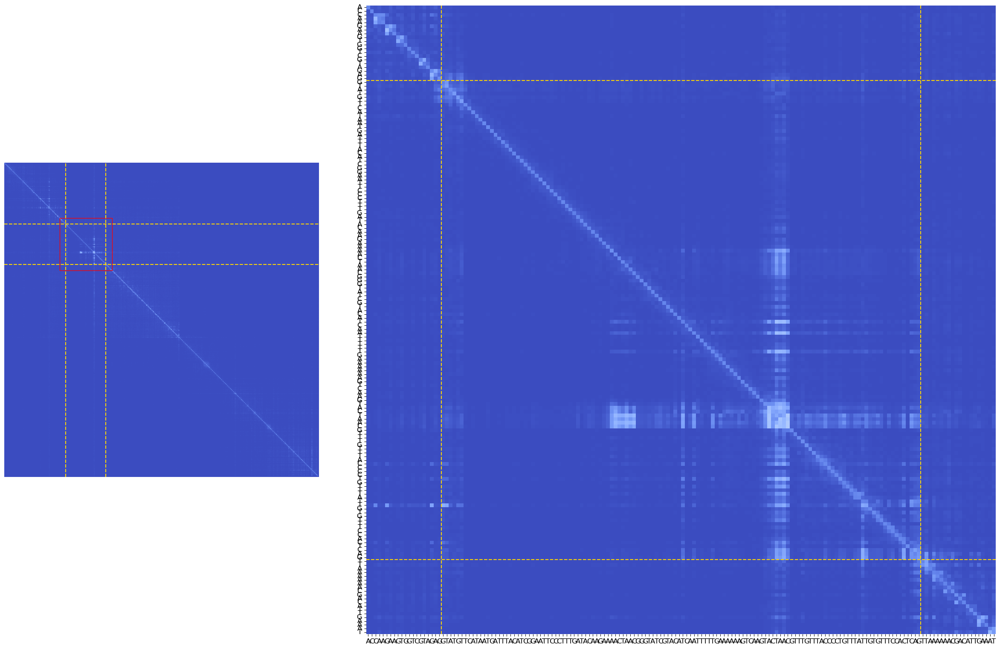

In [41]:
gene = 'YBL025W'
plot_splice_sites_w_matrix(gene, vmax=20)

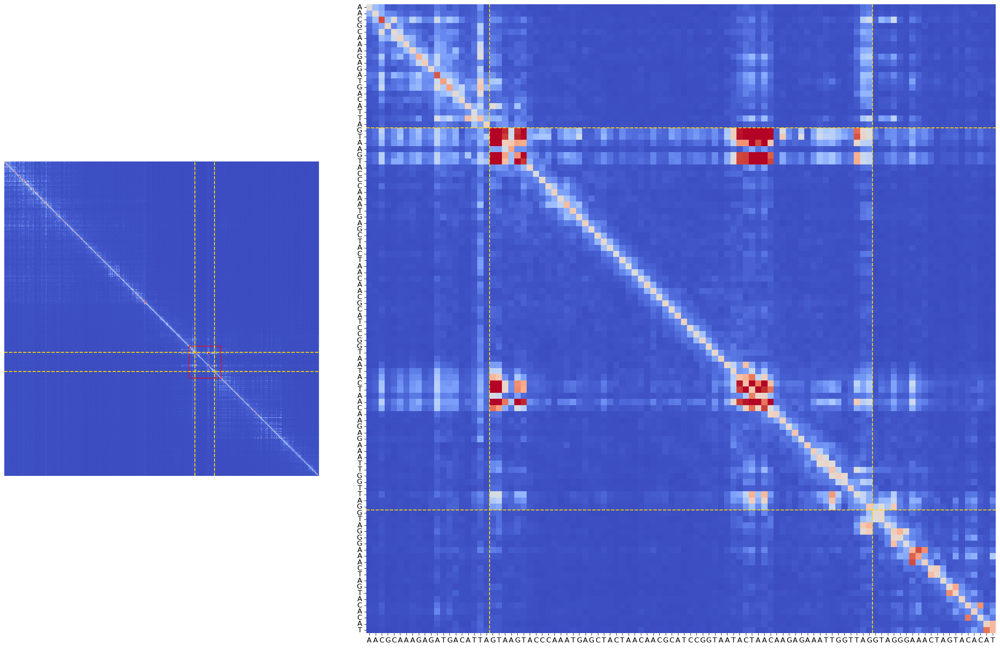

In [42]:
gene = 'YIL156W'
plot_splice_sites_w_matrix(gene)

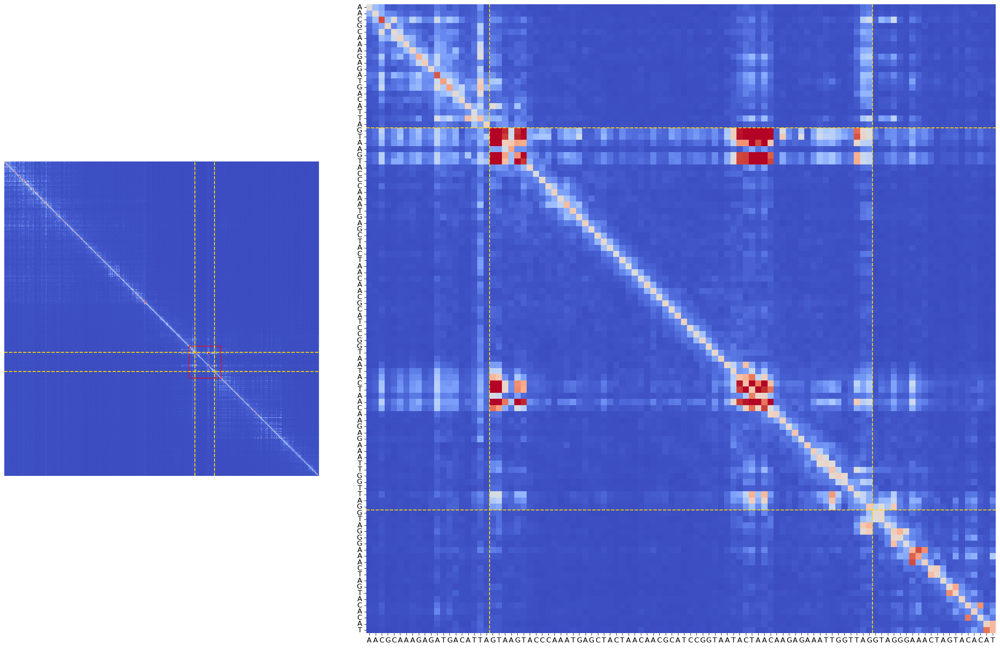

In [43]:
gene = 'YIL156W'
plot_splice_sites_w_matrix(gene)

In [55]:
introns_overlapping_unique_start_1000_df.loc[introns_overlapping_unique_start_1000_df.gene_id_start_codon==gene, 'intron_gene_id'].values[0]

'YBL026W'

In [ ]:
for gene in introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '+') & (introns_overlapping_unique_start_1000_df['Strand'] == '+')]['gene_id_start_codon']:
    print(gene)
    if introns_overlapping_unique_start_1000_df.loc[introns_overlapping_unique_start_1000_df.gene_id_start_codon==gene, 'intron_gene_id'].values[0].startswith('t'):
        continue
    plot_splice_sites_w_matrix(gene)

In [ ]:
for gene in introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '+') & (introns_overlapping_unique_start_1000_df['Strand'] == '+')]['gene_id_start_codon']:
    plot_splice_sites_w_matrix(gene)

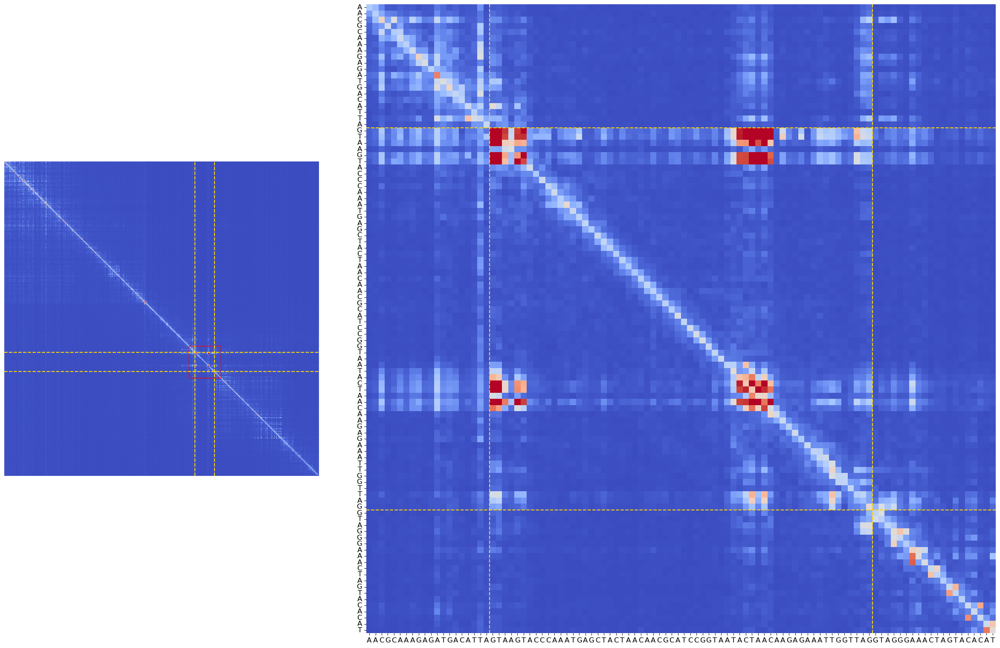

In [ ]:
gene = 'YIL156W'
plot_splice_sites_w_matrix(gene)

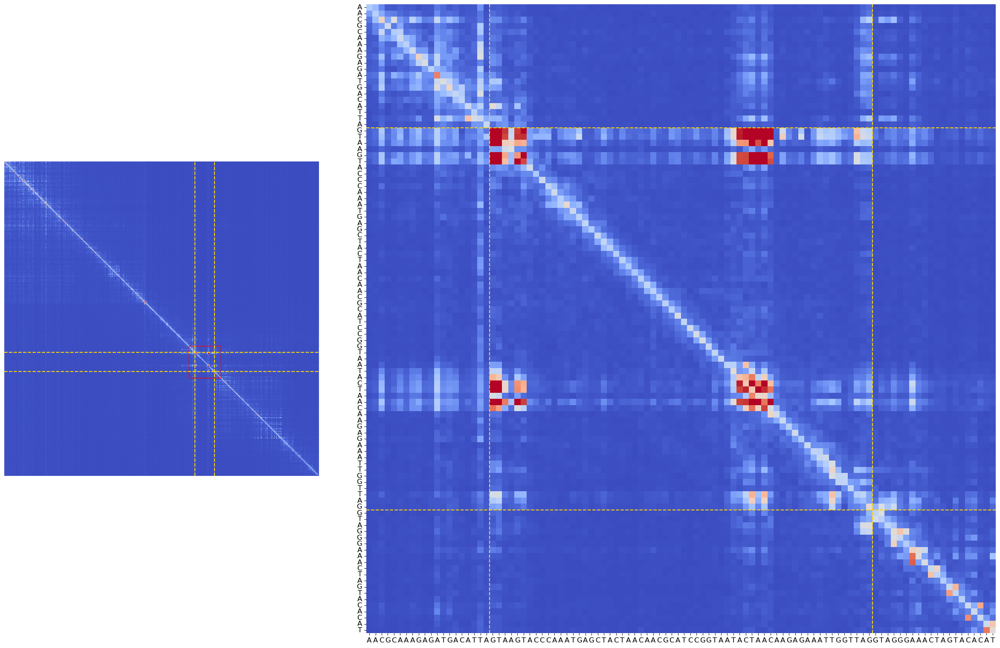

In [ ]:
gene = 'YIL156W'
plot_splice_sites_w_matrix(gene)

Intron in the + strand and start codon upstream sequence in the - strand

In [45]:
introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '-') & (introns_overlapping_unique_start_1000_df['Strand'] == '+')].iloc[:5, :]

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,fully_overlaps,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix
0,YAL030W,intron,I,87387,87500,+,87387,87389,87498,87500,...,True,0,356,358,467,469,644,642,533,531
1,tP(UGG)A,intron,I,139187,139218,+,139187,139189,139216,139218,...,True,1,842,844,871,873,158,156,129,127
3,YBL027W,intron,II,168424,168808,+,168424,168426,168806,168808,...,True,3,586,588,968,970,414,412,32,30
4,YBL050W,intron,II,125154,125270,+,125154,125156,125268,125270,...,True,4,395,397,509,511,605,603,491,489
6,YBR111W-A,intron,II,462209,462289,+,462209,462211,462287,462289,...,True,6,336,338,414,416,664,662,586,584


In [46]:
introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '-') & (introns_overlapping_unique_start_1000_df['Strand'] == '+')].iloc[:5, 20:]

,Strand_start_codon,Frame,gene_id_start_codon,gene_name,gene_source,gene_biotype,transcript_id,transcript_name,transcript_source,transcript_biotype,...,fully_overlaps,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix
0,-,0,YAL031C,GIP4,sgd,protein_coding,YAL031C_mRNA,GIP4,sgd,protein_coding,...,True,0,356,358,467,469,644,642,533,531
1,-,0,YAL007C,ERP2,sgd,protein_coding,YAL007C_mRNA,ERP2,sgd,protein_coding,...,True,1,842,844,871,873,158,156,129,127
3,-,0,YBL028C,NaN,sgd,protein_coding,YBL028C_mRNA,NaN,sgd,protein_coding,...,True,3,586,588,968,970,414,412,32,30
4,-,0,YBL051C,PIN4,sgd,protein_coding,YBL051C_mRNA,PIN4,sgd,protein_coding,...,True,4,395,397,509,511,605,603,491,489
6,-,0,YBR111C,YSA1,sgd,protein_coding,YBR111C_mRNA,YSA1,sgd,protein_coding,...,True,6,336,338,414,416,664,662,586,584


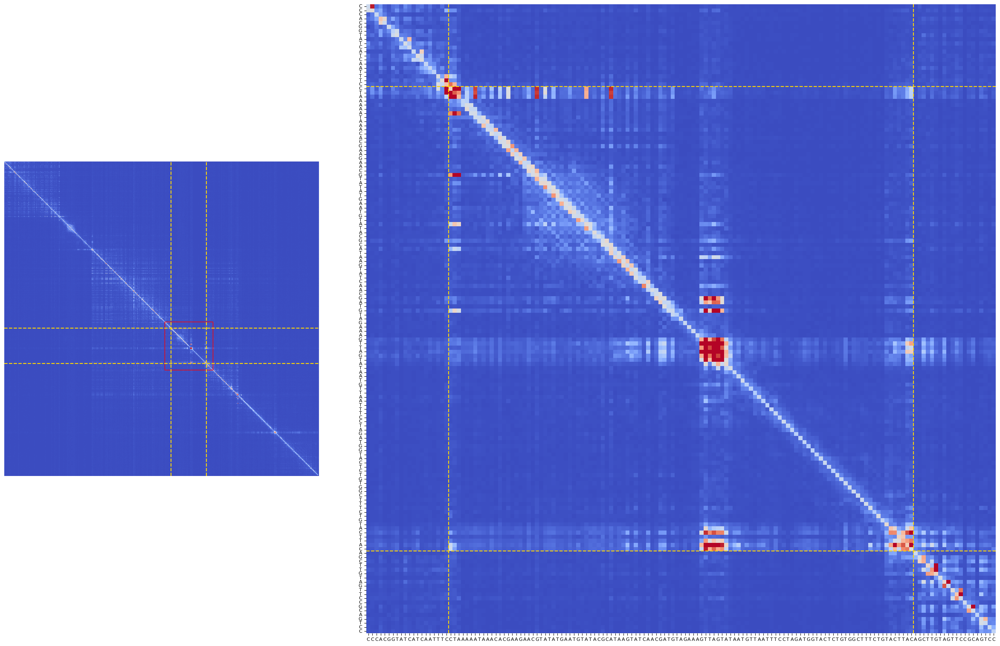

In [47]:
gene = 'YAL031C'
plot_splice_sites_w_matrix(gene, font_size=8)

Intron in the - strand and start codon upstream sequence in the + strand

In [48]:
introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '+') & (introns_overlapping_unique_start_1000_df['Strand'] == '-')].iloc[:5, :]

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,fully_overlaps,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix
12,YBL040C,intron,II,142749,142846,-,142844,142846,142749,142751,...,True,12,546,548,641,643,454,452,359,357
13,YBL059C-A,intron,II,110420,110505,-,110503,110505,110420,110422,...,True,13,88,90,171,173,912,910,829,827
25,YCL002C,intron,III,111557,111633,-,111631,111633,111557,111559,...,True,25,282,284,356,358,718,716,644,642
34,YDL012C,intron,IV,431386,431472,-,431470,431472,431386,431388,...,True,34,857,859,941,943,143,141,59,57
35,YDL115C,intron,IV,254974,255044,-,255042,255044,254974,254976,...,True,35,559,561,627,629,441,439,373,371


In [49]:
introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '+') & (introns_overlapping_unique_start_1000_df['Strand'] == '-')].iloc[:5, 20:]

,Strand_start_codon,Frame,gene_id_start_codon,gene_name,gene_source,gene_biotype,transcript_id,transcript_name,transcript_source,transcript_biotype,...,fully_overlaps,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix
12,+,0,YBL039W-B,NaN,sgd,protein_coding,YBL039W-B_mRNA,NaN,sgd,protein_coding,...,True,12,546,548,641,643,454,452,359,357
13,+,0,YBL059W,NaN,sgd,protein_coding,YBL059W_mRNA,NaN,sgd,protein_coding,...,True,13,88,90,171,173,912,910,829,827
25,+,0,YCL001W,RER1,sgd,protein_coding,YCL001W_mRNA,RER1,sgd,protein_coding,...,True,25,282,284,356,358,718,716,644,642
34,+,0,YDL010W,GRX6,sgd,protein_coding,YDL010W_mRNA,GRX6,sgd,protein_coding,...,True,34,857,859,941,943,143,141,59,57
35,+,0,YDL114W,NaN,sgd,protein_coding,YDL114W_mRNA,NaN,sgd,protein_coding,...,True,35,559,561,627,629,441,439,373,371


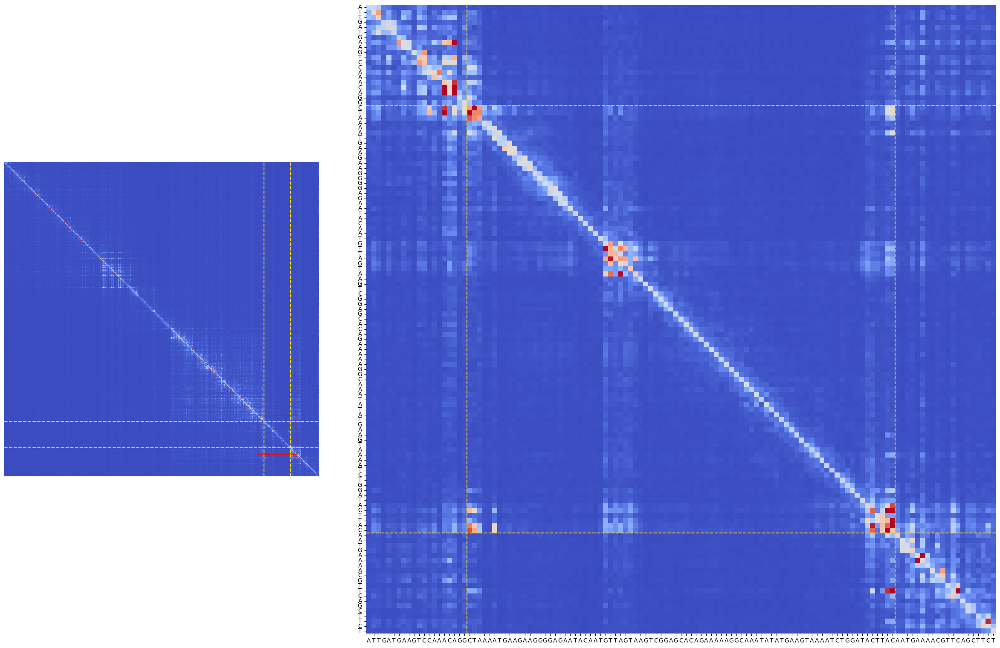

In [50]:
gene = 'YBL059W'
plot_splice_sites_w_matrix(gene, font_size=10)

Intron in the - strand and start codon upstream sequence in the - strand

In [51]:
introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '-') & (introns_overlapping_unique_start_1000_df['Strand'] == '-')].iloc[:5, :]

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,fully_overlaps,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix
14,YBR062C,intron,II,366502,366584,-,366582,366584,366502,366504,...,True,14,865,863,785,783,135,137,215,217
15,YBR084C-A,intron,II,414753,415259,-,415257,415259,414753,414755,...,True,15,506,504,2,0,494,496,998,1000
16,YBR090C,intron,II,426516,426873,-,426871,426873,426516,426518,...,True,16,384,382,29,27,616,618,971,973
17,YBR219C,intron,II,662581,663002,-,663000,663002,662581,662583,...,True,17,753,751,334,332,247,249,666,668
18,YBR230C,intron,II,679942,680039,-,680037,680039,679942,679944,...,True,18,818,816,723,721,182,184,277,279


In [52]:
introns_overlapping_unique_start_1000_df[(introns_overlapping_unique_start_1000_df['Strand_start_codon'] == '-') & (introns_overlapping_unique_start_1000_df['Strand'] == '-')].iloc[:5, 20:]

,Strand_start_codon,Frame,gene_id_start_codon,gene_name,gene_source,gene_biotype,transcript_id,transcript_name,transcript_source,transcript_biotype,...,fully_overlaps,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix
14,-,0,YBR061C,TRM7,sgd,protein_coding,YBR061C_mRNA,TRM7,sgd,protein_coding,...,True,14,865,863,785,783,135,137,215,217
15,-,1,YBR084C-A,RPL19A,sgd,protein_coding,YBR084C-A_mRNA,RPL19A,sgd,protein_coding,...,True,15,506,504,2,0,494,496,998,1000
16,-,0,YBR089C-A,NHP6B,sgd,protein_coding,YBR089C-A_mRNA,NHP6B,sgd,protein_coding,...,True,16,384,382,29,27,616,618,971,973
17,-,0,YBR218C,PYC2,sgd,protein_coding,YBR218C_mRNA,PYC2,sgd,protein_coding,...,True,17,753,751,334,332,247,249,666,668
18,-,0,YBR229C,ROT2,sgd,protein_coding,YBR229C_mRNA,ROT2,sgd,protein_coding,...,True,18,818,816,723,721,182,184,277,279


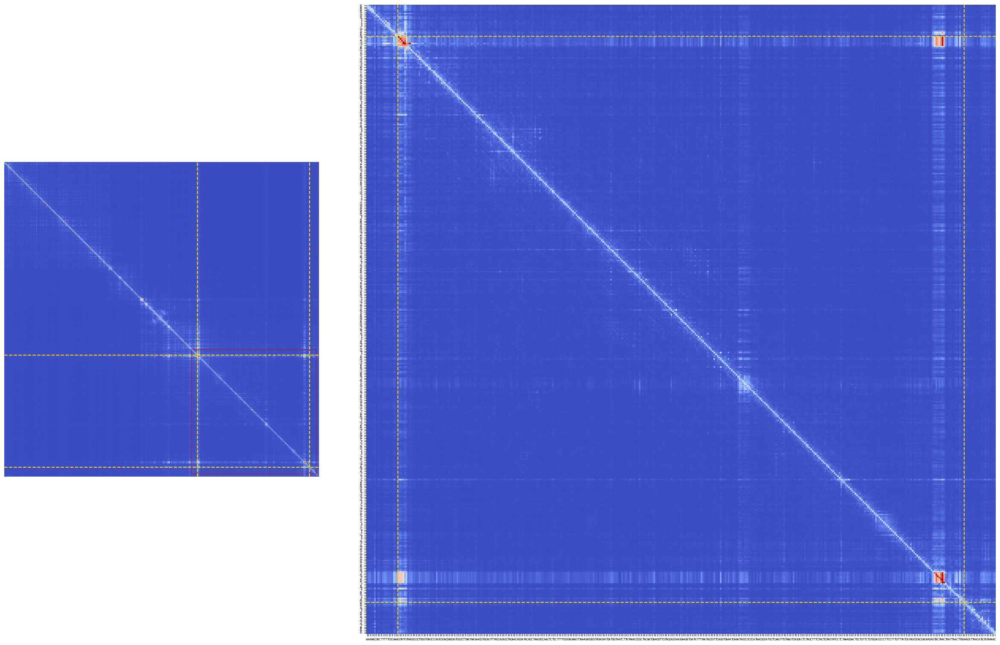

In [53]:
gene = 'YBR089C-A'
plot_splice_sites_w_matrix(gene, font_size=5)

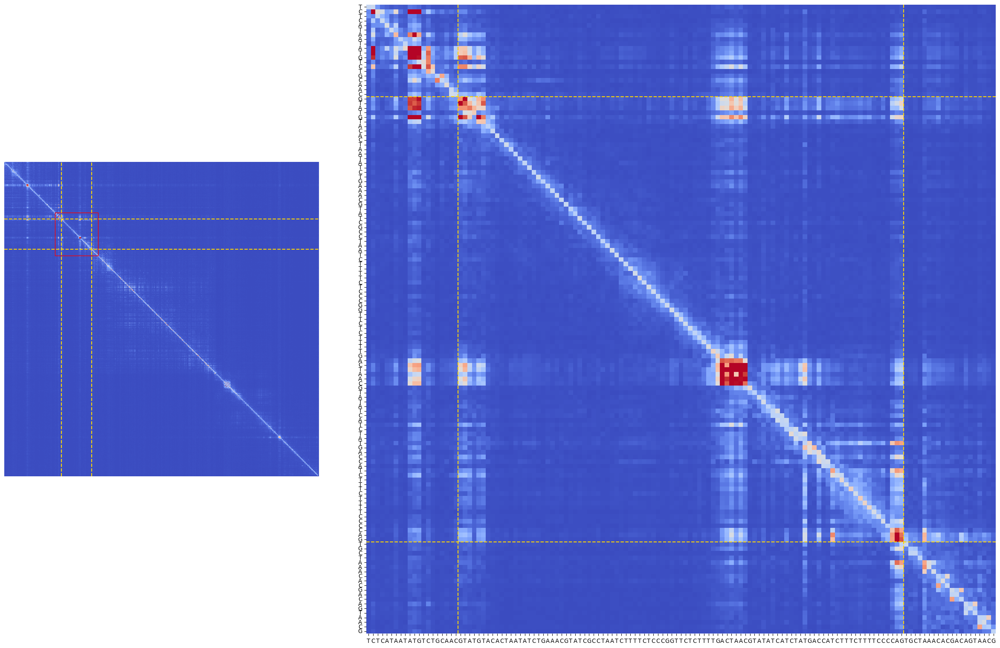

In [54]:
gene = 'YBR229C'
plot_splice_sites_w_matrix(gene, font_size=9.5)

## Benchmark donor acceptor and acceptor donor interaction vs negative set

In [44]:
# get intron seqs
introns_overlapping_unique_start_1000_pr = pr.PyRanges(introns_overlapping_unique_start_1000_df)

temp_unzipped_fasta_path = f'{species_of_interest}_temp.fa'
with gzip.open(fasta_path, 'rb') as f_in:
    with open(temp_unzipped_fasta_path, 'wb') as f_out:
        shutil.copyfileobj(f_in, f_out)

introns_overlapping_unique_start_1000_pr.intron_seq = pr.get_sequence(introns_overlapping_unique_start_1000_pr, path=temp_unzipped_fasta_path) # the gtf_start_codons_pr was extended 1000bp upstream before



#remove the unzipped fasta file
if os.path.exists(temp_unzipped_fasta_path):
    os.remove(temp_unzipped_fasta_path)

In [45]:
introns_overlapping_unique_start_1000_df = introns_overlapping_unique_start_1000_pr.df.copy()
introns_overlapping_unique_start_1000_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,intron_id,donor_rel_start,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix,intron_seq
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,0,356,361,467,469,644,639,533,531,GTAAGTACAGAAAGCCACAGAGTACCATCTAGGAAATTAACATTAT...
1,tP(UGG)A,intron,I,139187,139218,+,139187,139192,139216,139218,...,1,842,847,871,873,158,153,129,127,CGACTTCCTGATTAAACAGGAAGACAAAGCA
2,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,2,804,799,678,676,196,201,322,324,GTATGTTCATAATGATTTACATCGGAATTCCCTTTGATACAAGAAA...
3,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,3,586,591,968,970,414,409,32,30,GTATGTTTAACAGTGATACTAAATTTTGAACCTTTCACAAGATTTA...
4,YBL050W,intron,II,125154,125270,+,125154,125159,125268,125270,...,4,395,400,509,511,605,600,491,489,GTATGTAGTAGGGAAATATATCAAAGGAACAAAATGAAAGCTATGT...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,157,857,852,707,705,143,148,293,295,GTTCGTATTTTACGCATGGATTAACGGTTTTAAAGAATAACATCAA...
158,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,158,671,676,755,757,329,324,245,243,GTATGTTTTTCACCGACAATTTTCTTTCAAATTTGCTGATATTGCC...
159,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,159,309,314,403,405,691,686,597,595,GTATGTACAGATTAAGACACAAGAAAAAATTTGAACAATTATGATT...
160,snR17b,intron,XVI,281373,281503,-,281498,281503,281373,281375,...,160,618,623,746,748,382,377,254,252,GTATGTTTTATACCATATACTTTATTAGGAATATAACAAAGCATAC...


In [46]:
def find_ag_locations(sequence):
    return [i for i in range(len(sequence) - 1) if sequence[i:i+2] == 'AG'] #all locations will be with respect to the DOnor site

branchpoint_seq = 'TACTAAC'

introns_overlapping_unique_start_1000_df['AG_locations'] = introns_overlapping_unique_start_1000_df['intron_seq'].apply(find_ag_locations)
introns_overlapping_unique_start_1000_df['canonical_branchpoint_location'] = introns_overlapping_unique_start_1000_df['intron_seq'].apply(lambda seq: seq.find(branchpoint_seq))

In [48]:
# for each intron we will want to get the interval belonging to the positions relative to the start codon of the matrix of the AGs and the donor

def get_ag_donor_intervals_matrix(row): #LENGTH OF THE DONOR CAN VARY DEPENDENDING ON THE SPECIES, it is set before

    donor_rel_start_matrix = row.donor_rel_start_matrix
    donor_rel_end_matrix = row.donor_rel_end_matrix

    if row.Strand_start_codon == '+':
        if  row.Strand == '+':

            donor_interval_on_matrix = np.array([donor_rel_start_matrix, donor_rel_end_matrix])
            ag_intervals_on_matrix = np.array([[donor_rel_start_matrix + ag, donor_rel_start_matrix + ag + 2] for ag in row.AG_locations]).squeeze()

        elif row.Strand == '-':

            donor_interval_on_matrix = np.array([donor_rel_end_matrix, donor_rel_start_matrix])
            ag_intervals_on_matrix = np.array([[donor_rel_start_matrix - ag - 2, donor_rel_start_matrix - ag] for ag in row.AG_locations]).squeeze()

    elif row.Strand_start_codon == '-':

        if  row.Strand == '+':
            
            donor_interval_on_matrix = np.array([donor_rel_end_matrix, donor_rel_start_matrix])
            ag_intervals_on_matrix = np.array([[donor_rel_start_matrix - ag - 2, donor_rel_start_matrix - ag] for ag in row.AG_locations]).squeeze()

        elif row.Strand == '-':

            donor_interval_on_matrix = np.array([donor_rel_start_matrix, donor_rel_end_matrix])
            ag_intervals_on_matrix = np.array([[donor_rel_start_matrix + ag, donor_rel_start_matrix + ag + 2] for ag in row.AG_locations]).squeeze()
            
    canonical_AG_int = ag_intervals_on_matrix[-1, :] if len(row.AG_locations) > 1 else ag_intervals_on_matrix
    non_canonical_AG_int = ag_intervals_on_matrix[:-1, :] if len(row.AG_locations) > 1 else np.array([]) 
        
    return donor_interval_on_matrix, canonical_AG_int, non_canonical_AG_int

    


In [49]:
def get_ags_donor_ci_avg_values(row, print_values=False): 

    # get ci matrix if it throws an error return None
    ci_matrix = get_ci_matrix(row.gene_id_start_codon) # this can be improved by for example geting it from a batch
    
    if ci_matrix is None:
        return None, None, None

    donor_int, canonical_AG_int, non_canonical_AG_int = get_ag_donor_intervals_matrix(row)

    donor_acceptor_ci_values = ci_matrix[donor_int[0]:donor_int[1], canonical_AG_int[0]:canonical_AG_int[1]]
    print(donor_acceptor_ci_values) if print_values else None
    donor_acceptor_ci_values_mean = donor_acceptor_ci_values.mean()

    acceptor_donors_ci_values = ci_matrix[canonical_AG_int[0]:canonical_AG_int[1], donor_int[0]:donor_int[1]]
    print(acceptor_donors_ci_values) if print_values else None
    acceptor_donors_ci_values_mean = acceptor_donors_ci_values.mean()

    return donor_acceptor_ci_values_mean.item(), acceptor_donors_ci_values_mean.item()


In [50]:
canonical_introns_df = introns_overlapping_unique_start_1000_df[introns_overlapping_unique_start_1000_df.canonical_sites].copy()

In [51]:
canonical_introns_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,donor_rel_end,acceptor_rel_start,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix,intron_seq,AG_locations,canonical_branchpoint_location
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,361,467,469,644,639,533,531,GTAAGTACAGAAAGCCACAGAGTACCATCTAGGAAATTAACATTAT...,"[3, 8, 12, 18, 20, 30, 111]",45
2,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,799,678,676,196,201,322,324,GTATGTTCATAATGATTTACATCGGAATTCCCTTTGATACAAGAAA...,"[41, 79, 84, 126]",86
3,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,591,968,970,414,409,32,30,GTATGTTTAACAGTGATACTAAATTTTGAACCTTTCACAAGATTTA...,"[11, 39, 78, 80, 86, 91, 104, 111, 129, 136, 1...",337
4,YBL050W,intron,II,125154,125270,+,125154,125159,125268,125270,...,400,509,511,605,600,491,489,GTATGTAGTAGGGAAATATATCAAAGGAACAAAATGAAAGCTATGT...,"[6, 9, 24, 38, 63, 114]",71
5,YBL059W,intron,II,110879,110948,+,110879,110884,110946,110948,...,552,490,488,443,448,510,512,GTATGCATAGGCAATAACTTCGGCCTCATACTCAAAGAACACGTTT...,"[8, 35, 67]",45
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156,YPL031C,intron,XVI,492918,493020,-,493015,493020,492918,492920,...,527,622,624,478,473,378,376,GTATGTAGTTTTCTAGTCAAGTATCATTGGAAAGTAAAGAACTAGA...,"[6, 14, 19, 32, 37, 43, 71, 88, 100]",55
157,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,852,707,705,143,148,293,295,GTTCGTATTTTACGCATGGATTAACGGTTTTAAAGAATAACATCAA...,"[33, 96, 150]",107
158,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,676,755,757,329,324,245,243,GTATGTTTTTCACCGACAATTTTCTTTCAAATTTGCTGATATTGCC...,"[59, 84]",52
159,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,314,403,405,691,686,597,595,GTATGTACAGATTAAGACACAAGAAAAAATTTGAACAATTATGATT...,"[8, 14, 21, 51, 94]",-1


In [52]:
donor_acceptor_ci = canonical_introns_df.apply(get_ags_donor_ci_avg_values, axis=1)
donor_acceptor_ci

0       (0.9634805917739868, 1.1248853206634521)
2       (0.2649269998073578, 0.4123517870903015)
3         (2.275071620941162, 0.785906970500946)
4        (1.423882246017456, 0.9766368865966797)
5      (0.49697333574295044, 1.0674617290496826)
                         ...                    
156    (0.7715467214584351, 0.17814162373542786)
157     (1.2974998950958252, 0.4421766400337219)
158     (1.8340765237808228, 0.9628984332084656)
159      (1.527732014656067, 1.8483558893203735)
160    (0.40906399488449097, 0.7474406361579895)
Length: 122, dtype: object

In [53]:
canonical_introns_df['donor_acceptor_ci_avg_values'], canonical_introns_df['acceptor_donors_ci_avg_values'] = zip(*donor_acceptor_ci)

In [54]:
canonical_introns_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,acceptor_rel_end,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix,intron_seq,AG_locations,canonical_branchpoint_location,donor_acceptor_ci_avg_values,acceptor_donors_ci_avg_values
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,469,644,639,533,531,GTAAGTACAGAAAGCCACAGAGTACCATCTAGGAAATTAACATTAT...,"[3, 8, 12, 18, 20, 30, 111]",45,0.963481,1.124885
2,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,676,196,201,322,324,GTATGTTCATAATGATTTACATCGGAATTCCCTTTGATACAAGAAA...,"[41, 79, 84, 126]",86,0.264927,0.412352
3,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,970,414,409,32,30,GTATGTTTAACAGTGATACTAAATTTTGAACCTTTCACAAGATTTA...,"[11, 39, 78, 80, 86, 91, 104, 111, 129, 136, 1...",337,2.275072,0.785907
4,YBL050W,intron,II,125154,125270,+,125154,125159,125268,125270,...,511,605,600,491,489,GTATGTAGTAGGGAAATATATCAAAGGAACAAAATGAAAGCTATGT...,"[6, 9, 24, 38, 63, 114]",71,1.423882,0.976637
5,YBL059W,intron,II,110879,110948,+,110879,110884,110946,110948,...,488,443,448,510,512,GTATGCATAGGCAATAACTTCGGCCTCATACTCAAAGAACACGTTT...,"[8, 35, 67]",45,0.496973,1.067462
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156,YPL031C,intron,XVI,492918,493020,-,493015,493020,492918,492920,...,624,478,473,378,376,GTATGTAGTTTTCTAGTCAAGTATCATTGGAAAGTAAAGAACTAGA...,"[6, 14, 19, 32, 37, 43, 71, 88, 100]",55,0.771547,0.178142
157,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,705,143,148,293,295,GTTCGTATTTTACGCATGGATTAACGGTTTTAAAGAATAACATCAA...,"[33, 96, 150]",107,1.297500,0.442177
158,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,757,329,324,245,243,GTATGTTTTTCACCGACAATTTTCTTTCAAATTTGCTGATATTGCC...,"[59, 84]",52,1.834077,0.962898
159,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,405,691,686,597,595,GTATGTACAGATTAAGACACAAGAAAAAATTTGAACAATTATGATT...,"[8, 14, 21, 51, 94]",-1,1.527732,1.848356


/opt/modules/i12g/anaconda/envs/fungi_code/lib/python3.8/site-packages/plotnine/layer.py:364: PlotnineWarning: geom_point : Removed 3 rows containing missing values.


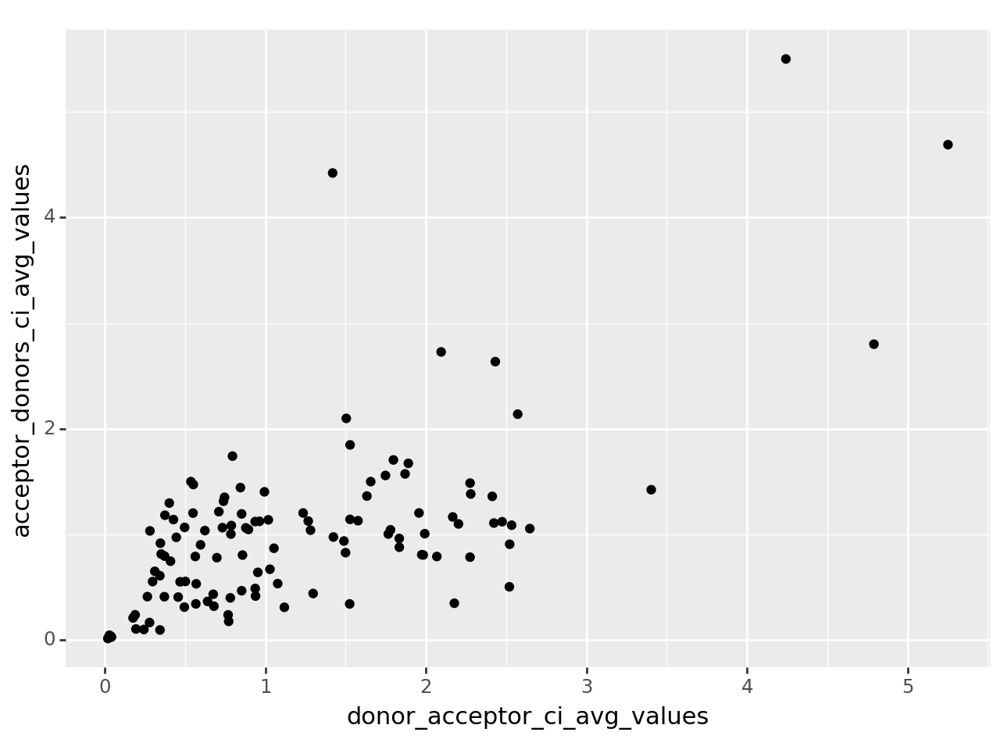

<Figure Size: (640 x 480)>

In [53]:
(ggplot(canonical_introns_df, aes(x='donor_acceptor_ci_avg_values', y='acceptor_donors_ci_avg_values')) + geom_point())

/opt/modules/i12g/anaconda/envs/fungi_code/lib/python3.8/site-packages/plotnine/layer.py:364: PlotnineWarning: geom_point : Removed 3 rows containing missing values.


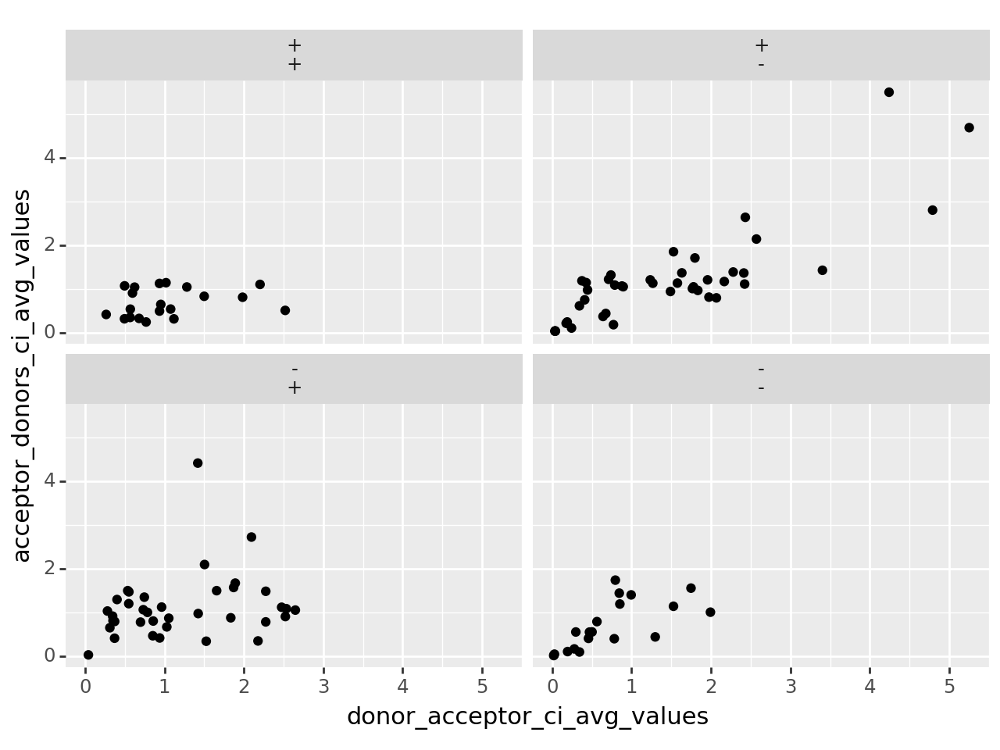

<Figure Size: (640 x 480)>

In [54]:
(ggplot(canonical_introns_df, aes(x='donor_acceptor_ci_avg_values', y='acceptor_donors_ci_avg_values')) + geom_point() + facet_wrap('~Strand_start_codon + Strand'))

/opt/modules/i12g/anaconda/envs/fungi_code/lib/python3.8/site-packages/plotnine/layer.py:284: PlotnineWarning: stat_boxplot : Removed 6 rows containing non-finite values.


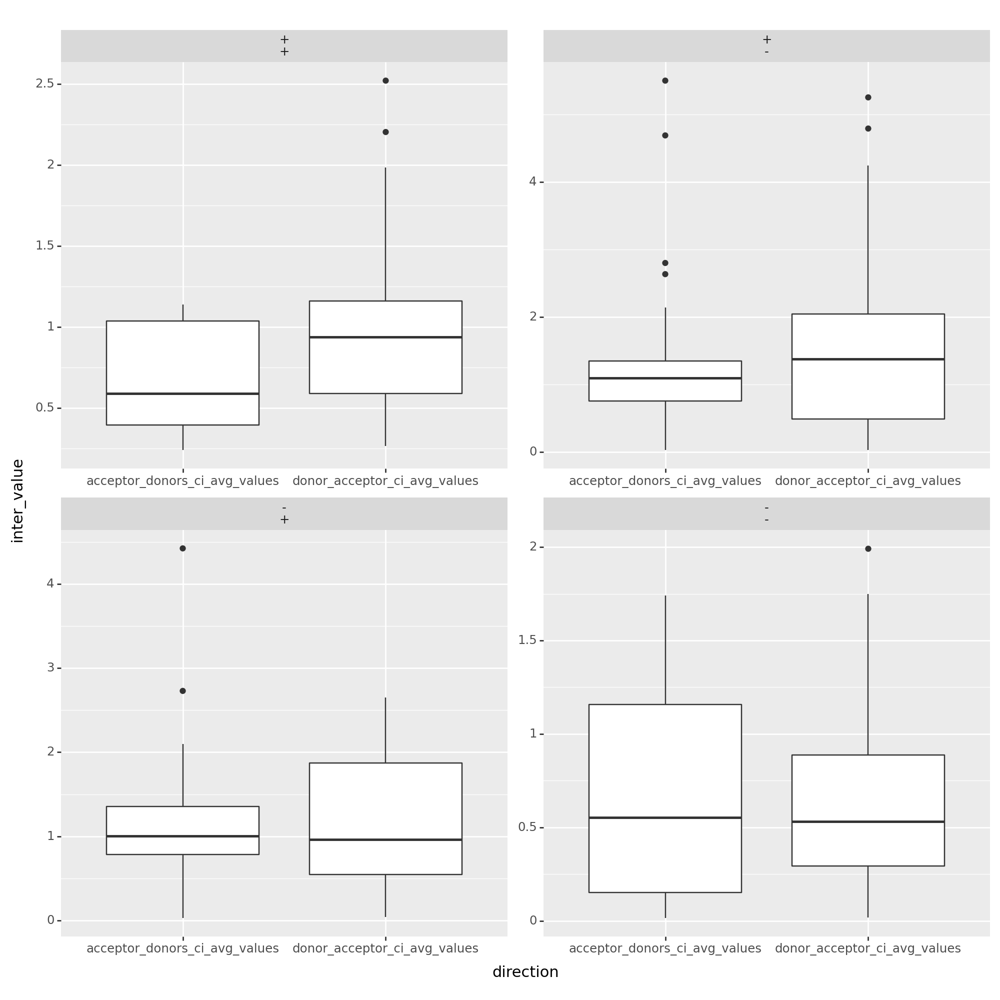

<Figure Size: (1000 x 1000)>

In [55]:
assert len(canonical_introns_df) == len(canonical_introns_df.intron_id.unique())
plot_df = canonical_introns_df.loc[:, ['intron_id', 'Strand', 'Strand_start_codon', 'donor_acceptor_ci_avg_values',
    'acceptor_donors_ci_avg_values']].melt(id_vars=['intron_id', 'Strand', 'Strand_start_codon'], 
    var_name='direction', value_name='inter_value').reset_index()

(ggplot(plot_df, aes(x='direction', y='inter_value')) + geom_boxplot() + facet_wrap('~Strand_start_codon + Strand', scales='free') 
    + theme(figure_size=(10, 10)))

### Check all possible intron strand and start codon upstream region strand combinations in 4 examples

#### ++ 

tensor([[2.7261, 2.4008],
        [2.8484, 2.5407],
        [1.9244, 1.8785],
        [0.6515, 0.7148],
        [2.1633, 1.9865]])
tensor([[1.7423, 1.9276, 0.3106, 0.3178, 0.7713],
        [1.0332, 1.1707, 0.1814, 0.2951, 0.3154]])


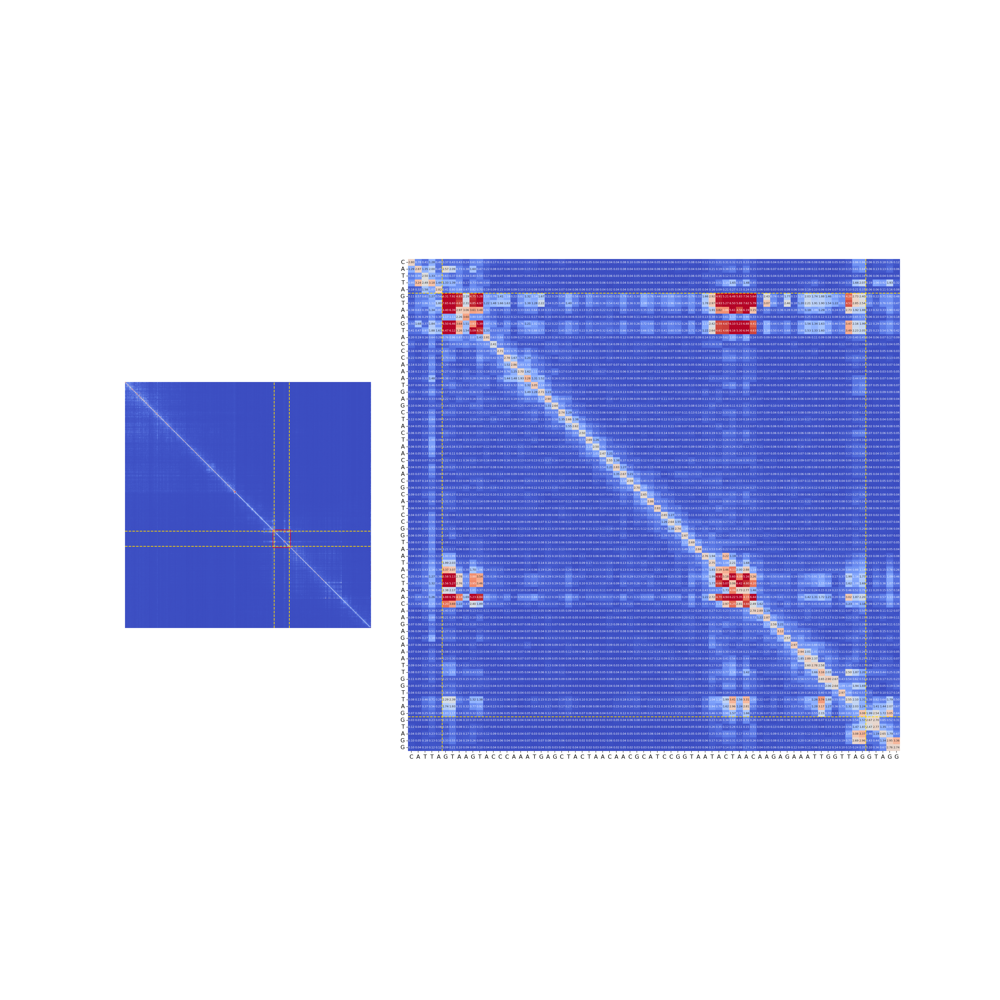

In [56]:
gene = 'YIL156W'
get_ags_donor_ci_avg_values(canonical_introns_df[canonical_introns_df.gene_id_start_codon == gene].iloc[0], print_values=True)
plot_splice_sites_w_matrix(gene, display_values=True, annot_size=6, zoom_slack=5)

#### +- (start codon upstream strand, intron strand)

tensor([[1.1921, 1.3117],
        [1.1877, 1.3111]])
tensor([[1.2771, 2.2088],
        [1.5825, 2.5645]])


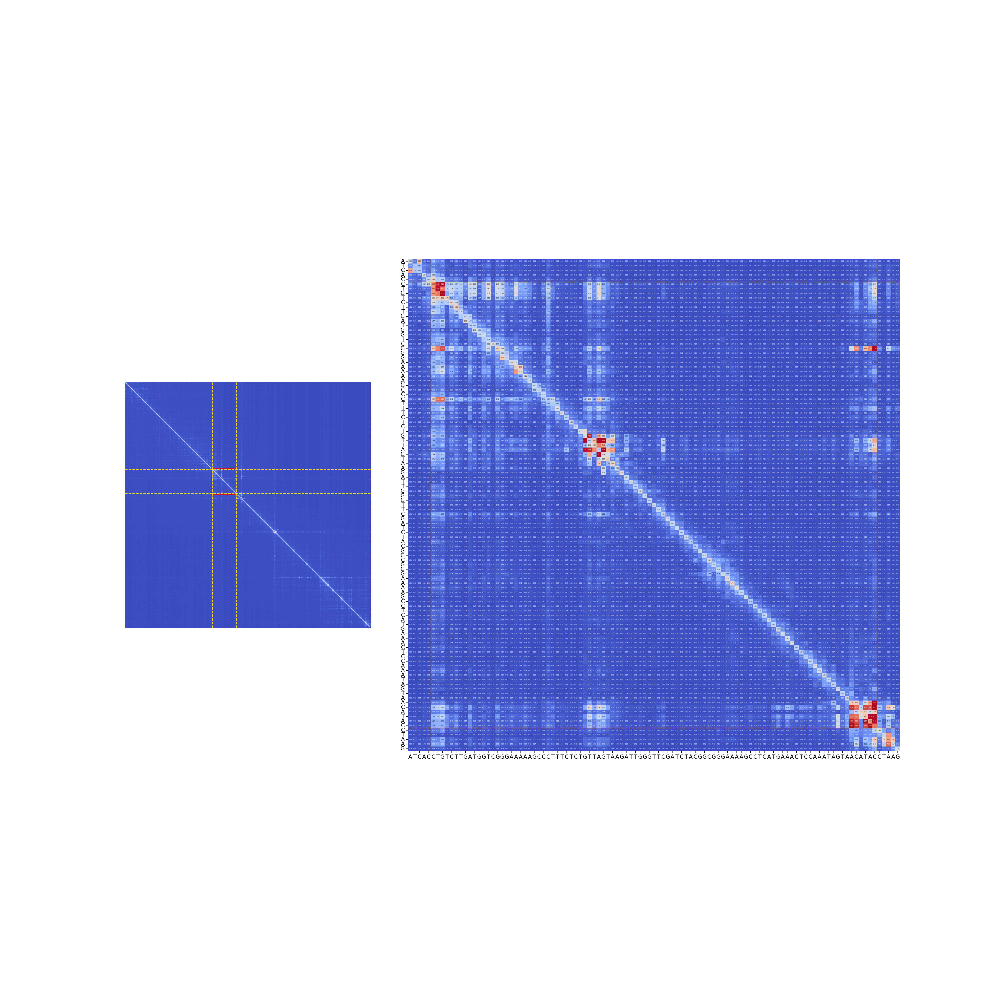

In [75]:
gene = 'YBL039W-B'
get_ags_donor_ci_avg_values(canonical_introns_df[canonical_introns_df.gene_id_start_codon == gene].iloc[0], print_values=True)
plot_splice_sites_w_matrix(gene, display_values=True, annot_size=3, zoom_slack=5)

#### --

tensor([[1.6740, 1.9994],
        [2.2815, 2.8483]])
tensor([[1.4332, 1.5411],
        [1.1174, 1.1515]])


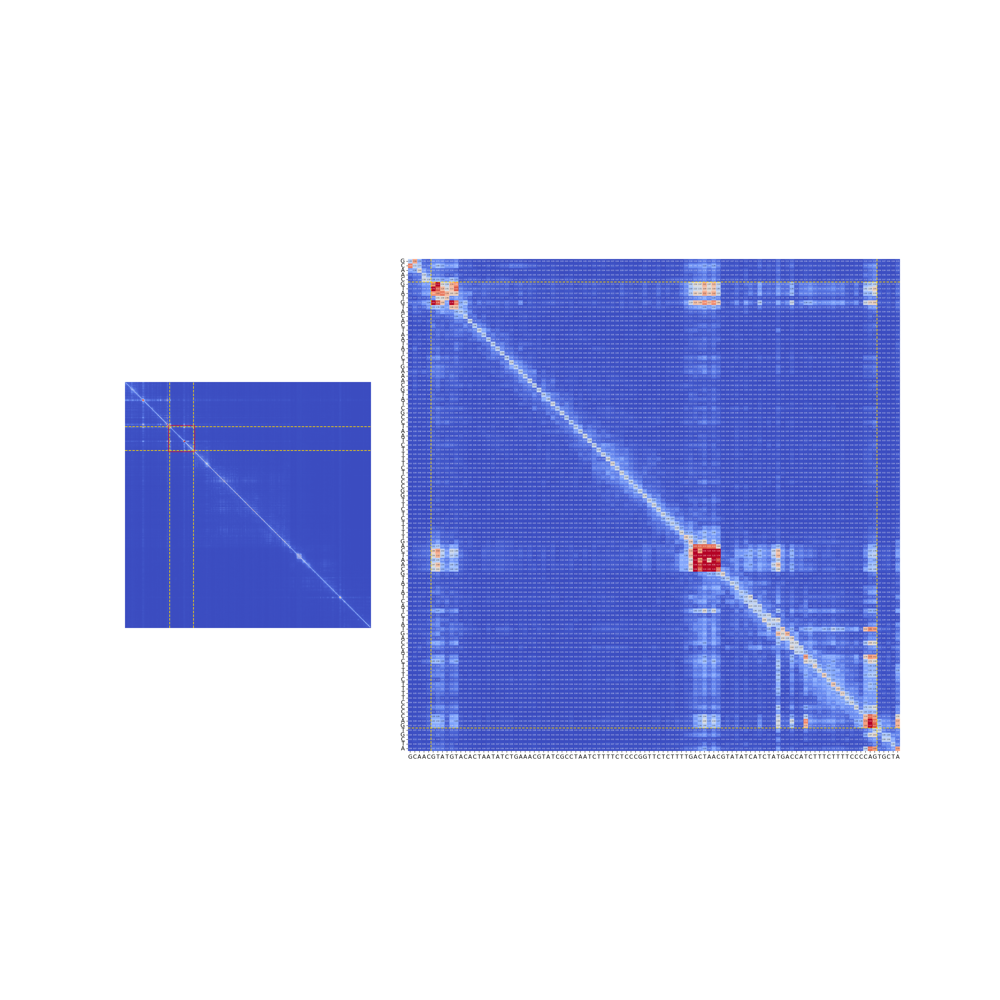

In [76]:
gene = 'YBR229C'
get_ags_donor_ci_avg_values(canonical_introns_df[canonical_introns_df.gene_id_start_codon == gene].iloc[0], print_values=True)
plot_splice_sites_w_matrix(gene, display_values=True, annot_size=3.5, zoom_slack=5)

#### -+

tensor([[2.1652, 1.4572],
        [2.2120, 1.0583]])
tensor([[1.2050, 2.0021],
        [1.2862, 1.9452]])


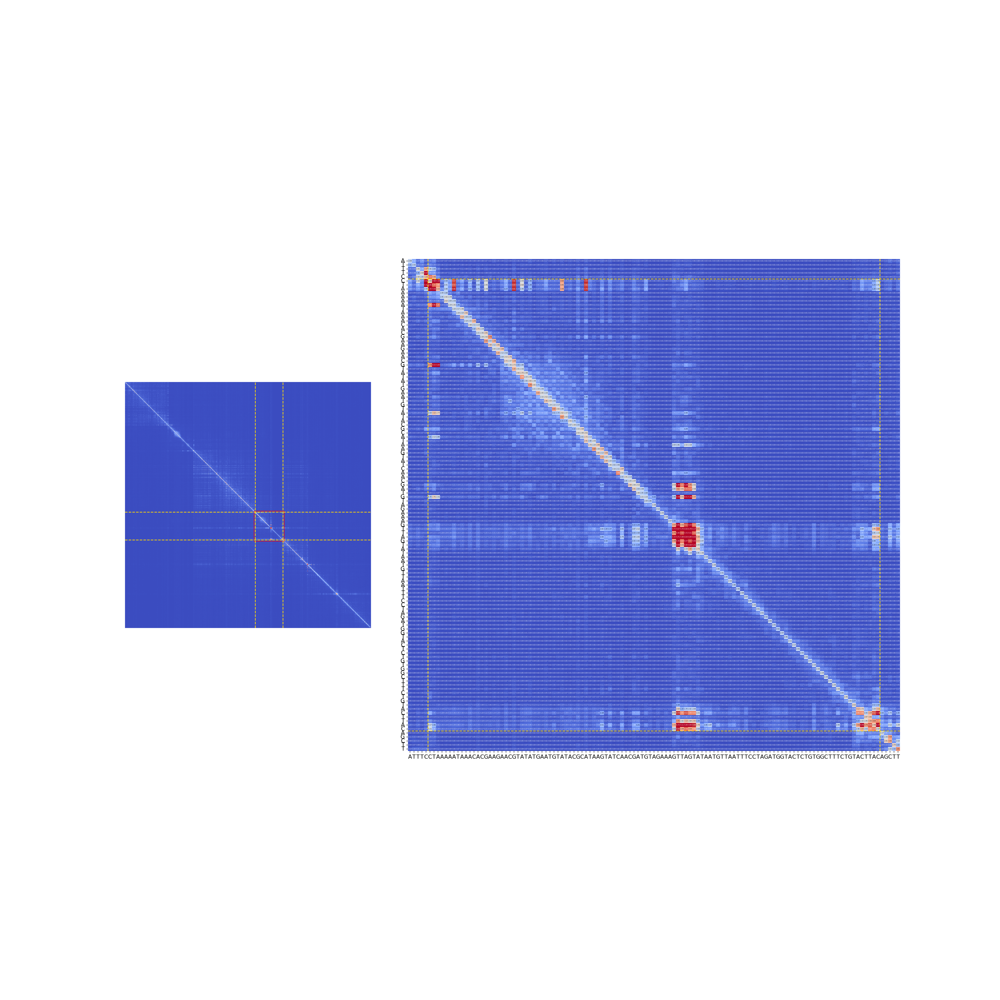

In [77]:
gene = 'YAL031C'
get_ags_donor_ci_avg_values(canonical_introns_df[canonical_introns_df.gene_id_start_codon == gene].iloc[0], print_values=True)
plot_splice_sites_w_matrix(gene, display_values=True, annot_size=3.5, zoom_slack=5)

all of the combinations and examples work out, all the genomic coordinates and ci matrix value seem to be safe :)

### Substitution based becnhmark

In [55]:
def get_mean_ci_values_random_equidistant_positions(ci_matrix, donor_int, canonical_AG_int, num_samples=5):

    donor_length = donor_int[1] - donor_int[0]

    # abs distance between donor and acceptor 
    k = abs(donor_int[0]-canonical_AG_int[0])

    rows = torch.arange(ci_matrix.size(0)).unsqueeze(1)  # Column vector
    cols = torch.arange(ci_matrix.size(1)).unsqueeze(0)  # Row vector

    # Find where abs(i - j) = k
    mask = torch.abs(rows - cols) == k

    coords = torch.nonzero(mask)

    # Extract coordinates
    coords = torch.nonzero(mask)

    # Exclude the coordinates including donor_int[0], canonical_AG_int[0], canonical_AG_int[1], donor_int[1]
    excluded_rows = (coords[:, 0] != donor_int[0]) & (coords[:, 0] != canonical_AG_int[0]) & (coords[:, 0] != canonical_AG_int[1]) & (coords[:, 0] != donor_int[1])
    excluded_cols = (coords[:, 1] != donor_int[0]) & (coords[:, 1] != canonical_AG_int[0]) & (coords[:, 1] != canonical_AG_int[1]) & (coords[:, 1] != donor_int[1])
    coords_filtered = coords[excluded_rows & excluded_cols]

    # Adjust coords_filtered to ensure a rectangle of donor size, acceptor size dims can be formed
    coords_adjusted = coords_filtered[(coords_filtered[:, 0] < ci_matrix.size(0) - donor_length) & (coords_filtered[:, 1] < ci_matrix.size(1) - donor_length)]

    # Ensure there are enough coordinates to sample
    if len(coords_adjusted) < num_samples:
        raise ValueError("Not enough valid coordinates to sample from")

    # Randomly sample num_samples different coordinates
    indices = torch.randperm(len(coords_adjusted))[:num_samples]
    sampled_coords = coords_adjusted[indices]

    # Using sampled coordinates to get coordintates of the rectangles of size donor_length x acceptor_length
    ci_random_pos_values = [ci_matrix[i:i+donor_length, j:j+2].mean().item() for i, j in sampled_coords]

    return ci_random_pos_values

In [56]:
def get_ags_donor_ci_avg_values(row, print_values=False, sample_random_equidistant_ci_values=False, num_samples=5): 

    #set random seed
    torch.manual_seed(0)
    # get ci matrix if it throws an error return None
    ci_matrix = get_ci_matrix(transcript_id=row.transcript_id) # this can be improved by for example geting it from a batch
    
    if ci_matrix is None:
        return np.nan, np.nan, np.nan

    donor_int, canonical_AG_int, non_canonical_AG_int = get_ag_donor_intervals_matrix(row)

    donor_acceptor_ci_values = ci_matrix[donor_int[0]:donor_int[1], canonical_AG_int[0]:canonical_AG_int[1]]
    print(donor_acceptor_ci_values) if print_values else None
    donor_acceptor_ci_values_mean = donor_acceptor_ci_values.mean()

    acceptor_donors_ci_values = ci_matrix[canonical_AG_int[0]:canonical_AG_int[1], donor_int[0]:donor_int[1]]
    print(acceptor_donors_ci_values) if print_values else None
    acceptor_donors_ci_values_mean = acceptor_donors_ci_values.mean()


    if sample_random_equidistant_ci_values:
        random_equidistant_ci_values = get_mean_ci_values_random_equidistant_positions(ci_matrix, donor_int, canonical_AG_int, num_samples=num_samples)

    if sample_random_equidistant_ci_values:
        return donor_acceptor_ci_values_mean.item(), acceptor_donors_ci_values_mean.item(), random_equidistant_ci_values
    elif len(non_canonical_AG_int) > 0:
        non_canonical_AG_ci_values_mean_list = []
        for int_bounds in non_canonical_AG_int:
            non_canonical_AG_ci_values = ci_matrix[donor_int[0]:donor_int[1], int_bounds[0]:int_bounds[1]]
            non_canonical_AG_ci_values_mean_list.append(non_canonical_AG_ci_values.mean().item())
        return donor_acceptor_ci_values_mean.item(), acceptor_donors_ci_values_mean.item(), non_canonical_AG_ci_values_mean_list
    else:
        return donor_acceptor_ci_values_mean.item(), acceptor_donors_ci_values_mean.item(), np.nan


tensor([[2.7261, 2.4008],
        [2.8484, 2.5407],
        [1.9244, 1.8785],
        [0.6515, 0.7148],
        [2.1633, 1.9865]])
tensor([[1.7423, 1.9276, 0.3106, 0.3178, 0.7713],
        [1.0332, 1.1707, 0.1814, 0.2951, 0.3154]])


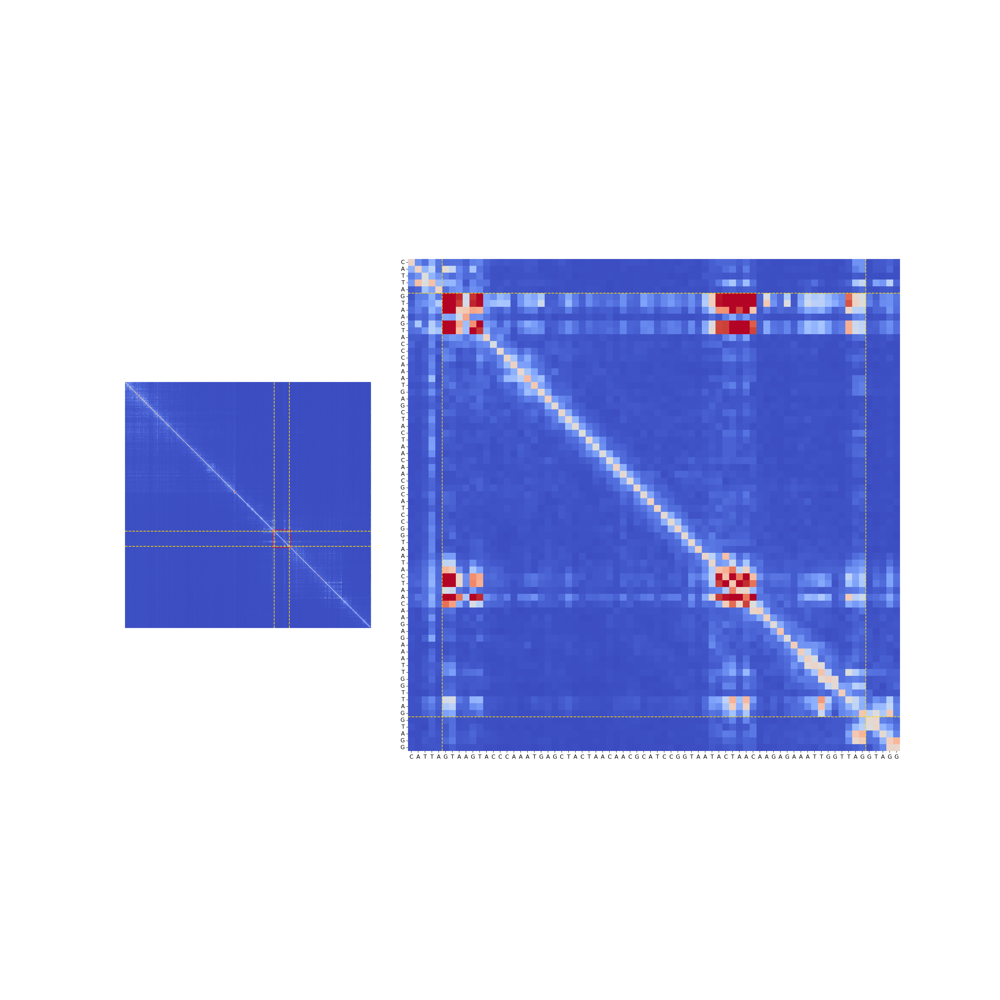

In [59]:
transcript = 'YIL156W_mRNA'
get_ags_donor_ci_avg_values(canonical_introns_df[canonical_introns_df.transcript_id == transcript].iloc[0], print_values=True)
plot_splice_sites_w_matrix(transcript_id=transcript, display_values=False, annot_size=6, zoom_slack=5, vmax=5)

In [57]:
donor_acceptor_ci_values_mean, acceptor_donors_ci_values_mean, random_ci_values = get_ags_donor_ci_avg_values(
    canonical_introns_df[canonical_introns_df.gene_id_start_codon == 'YIL156W'].iloc[0],sample_random_equidistant_ci_values=True)

In [61]:
donor_acceptor_ci_values_mean

1.9834884405136108

In [62]:
random_ci_values

[0.08549134433269501,
 0.08529046177864075,
 0.03529854863882065,
 0.05593974143266678,
 0.07736621052026749]

In [58]:
canonical_introns_df = introns_overlapping_unique_start_1000_df[introns_overlapping_unique_start_1000_df.canonical_sites].copy().reset_index(drop=True)
donor_acceptor_ci = canonical_introns_df.apply(get_ags_donor_ci_avg_values, axis=1, sample_random_equidistant_ci_values=True,  num_samples=4)
donor_acceptor_ci

0      (0.9634805917739868, 1.1248853206634521, [0.04...
1      (0.2649269998073578, 0.4123517870903015, [0.02...
2      (2.275071620941162, 0.785906970500946, [0.0139...
3      (1.423882246017456, 0.9766368865966797, [0.036...
4      (0.49697333574295044, 1.0674617290496826, [0.0...
                             ...                        
117    (0.7715467214584351, 0.17814162373542786, [0.0...
118    (1.2974998950958252, 0.4421766400337219, [0.82...
119    (1.8340765237808228, 0.9628984332084656, [0.02...
120    (1.527732014656067, 1.8483558893203735, [0.047...
121    (0.40906399488449097, 0.7474406361579895, [0.0...
Length: 122, dtype: object

In [59]:
donor_acceptor_ci_df = pd.DataFrame(donor_acceptor_ci.to_list(), columns = ['donor_acceptor_ci_avg_values', 'acceptor_donors_ci_avg_values', 'random_ci_values'])
donor_acceptor_ci_df

,donor_acceptor_ci_avg_values,acceptor_donors_ci_avg_values,random_ci_values
0,0.963481,1.124885,"[0.045251645147800446, 0.04401097819209099, 0...."
1,0.264927,0.412352,"[0.027549346908926964, 0.023981573060154915, 0..."
2,2.275072,0.785907,"[0.013915985822677612, 0.014045780524611473, 0..."
3,1.423882,0.976637,"[0.03627309575676918, 0.015240581706166267, 0...."
4,0.496973,1.067462,"[0.0484706349670887, 0.048683471977710724, 0.0..."
...,...,...,...
117,0.771547,0.178142,"[0.04254376143217087, 0.2892245650291443, 0.24..."
118,1.297500,0.442177,"[0.827362060546875, 0.17494848370552063, 0.093..."
119,1.834077,0.962898,"[0.028719592839479446, 0.029255304485559464, 0..."
120,1.527732,1.848356,"[0.047819823026657104, 0.043192267417907715, 0..."


In [60]:
assert len(canonical_introns_df) == len(donor_acceptor_ci_df)
canonical_introns_df = pd.concat([canonical_introns_df, donor_acceptor_ci_df], axis=1)
canonical_introns_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix,intron_seq,AG_locations,canonical_branchpoint_location,donor_acceptor_ci_avg_values,acceptor_donors_ci_avg_values,random_ci_values
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,644,639,533,531,GTAAGTACAGAAAGCCACAGAGTACCATCTAGGAAATTAACATTAT...,"[3, 8, 12, 18, 20, 30, 111]",45,0.963481,1.124885,"[0.045251645147800446, 0.04401097819209099, 0...."
1,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,196,201,322,324,GTATGTTCATAATGATTTACATCGGAATTCCCTTTGATACAAGAAA...,"[41, 79, 84, 126]",86,0.264927,0.412352,"[0.027549346908926964, 0.023981573060154915, 0..."
2,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,414,409,32,30,GTATGTTTAACAGTGATACTAAATTTTGAACCTTTCACAAGATTTA...,"[11, 39, 78, 80, 86, 91, 104, 111, 129, 136, 1...",337,2.275072,0.785907,"[0.013915985822677612, 0.014045780524611473, 0..."
3,YBL050W,intron,II,125154,125270,+,125154,125159,125268,125270,...,605,600,491,489,GTATGTAGTAGGGAAATATATCAAAGGAACAAAATGAAAGCTATGT...,"[6, 9, 24, 38, 63, 114]",71,1.423882,0.976637,"[0.03627309575676918, 0.015240581706166267, 0...."
4,YBL059W,intron,II,110879,110948,+,110879,110884,110946,110948,...,443,448,510,512,GTATGCATAGGCAATAACTTCGGCCTCATACTCAAAGAACACGTTT...,"[8, 35, 67]",45,0.496973,1.067462,"[0.0484706349670887, 0.048683471977710724, 0.0..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117,YPL031C,intron,XVI,492918,493020,-,493015,493020,492918,492920,...,478,473,378,376,GTATGTAGTTTTCTAGTCAAGTATCATTGGAAAGTAAAGAACTAGA...,"[6, 14, 19, 32, 37, 43, 71, 88, 100]",55,0.771547,0.178142,"[0.04254376143217087, 0.2892245650291443, 0.24..."
118,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,143,148,293,295,GTTCGTATTTTACGCATGGATTAACGGTTTTAAAGAATAACATCAA...,"[33, 96, 150]",107,1.297500,0.442177,"[0.827362060546875, 0.17494848370552063, 0.093..."
119,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,329,324,245,243,GTATGTTTTTCACCGACAATTTTCTTTCAAATTTGCTGATATTGCC...,"[59, 84]",52,1.834077,0.962898,"[0.028719592839479446, 0.029255304485559464, 0..."
120,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,691,686,597,595,GTATGTACAGATTAAGACACAAGAAAAAATTTGAACAATTATGATT...,"[8, 14, 21, 51, 94]",-1,1.527732,1.848356,"[0.047819823026657104, 0.043192267417907715, 0..."


In [61]:
donor_acceptor_values = donor_acceptor_ci_df['donor_acceptor_ci_avg_values'].values
acceptor_donors_values = donor_acceptor_ci_df['acceptor_donors_ci_avg_values'].values

In [62]:
random_equidistant_values = np.concatenate(donor_acceptor_ci_df['random_ci_values'].dropna().values)
random_equidistant_values.shape

(476,)

In [63]:
from sklearn.metrics import precision_recall_curve,auc
import matplotlib.pyplot as plt

def get_pr_values(donor_acceptor_values, acceptor_donors_values, negative_set='random'):
    #only keep non na values
    pos_class_values = np.concatenate([donor_acceptor_values[~np.isnan(donor_acceptor_values)], acceptor_donors_values[~np.isnan(acceptor_donors_values)]])
    if negative_set == 'random':
        neg_class_values = np.concatenate(donor_acceptor_ci_df['random_ci_values'].dropna().values)
    elif negative_set == 'non_can_ags':
        neg_class_values = np.concatenate(donor_acceptor_ci_df['non_can_ag_ci_values'].dropna().values)

    # Create labels: 1 for positive class, 0 for negative class
    pos_labels = np.ones(len(pos_class_values))
    neg_labels = np.zeros(len(neg_class_values))

    # Concatenate values and labels
    values = np.concatenate([pos_class_values, neg_class_values])
    labels = np.concatenate([pos_labels, neg_labels])

    # Calculate precision and recall
    precision, recall, _ = precision_recall_curve(labels, values)

    return precision, recall, len(pos_labels), len(neg_labels)

def plot_pr_curve(precision, recall):
    auc_score = auc(recall, precision)

    plt.figure()
    plt.step(recall, precision, where='post')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.text(0.7, 0.1, f'AUC: {auc_score:.2f}', fontsize=12, transform=plt.gca().transAxes)  # Adjust position relative to y limits
    plt.show()



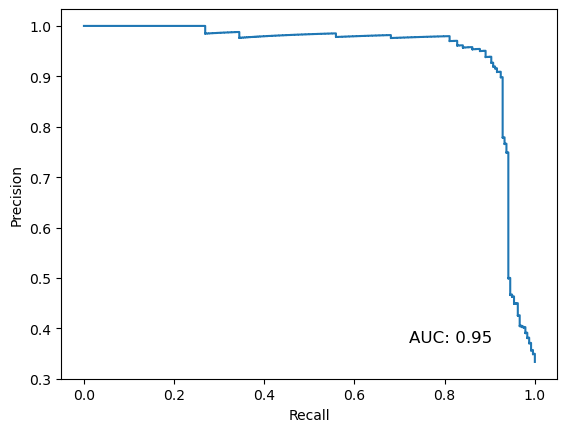

In [64]:
precision_snp_based_rand, recall_snp_based_rand, len_pos_snp_based_rand, len_neg_snp_based_rand = get_pr_values(donor_acceptor_values, acceptor_donors_values, negative_set='random')

plot_pr_curve(precision_snp_based_rand, recall_snp_based_rand)

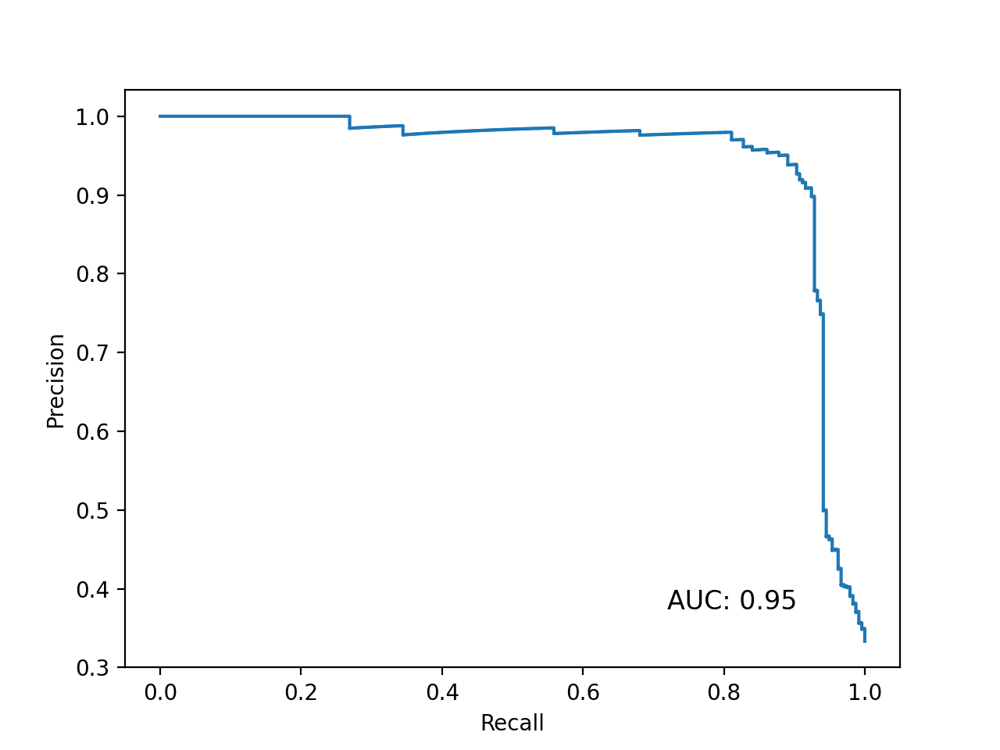

In [69]:
precision_snp_based_rand, recall_snp_based_rand, len_pos_snp_based_rand, len_neg_snp_based_rand = get_pr_values(donor_acceptor_values, acceptor_donors_values, negative_set='random')

plot_pr_curve(precision_snp_based_rand, recall_snp_based_rand)

In [72]:
from matplotlib.ticker import MaxNLocator

def plot_pr_curve(precision, recall, figsize=(4, 3), num_ticks=7):
    auc_score = auc(recall, precision)

    plt.figure(figsize=figsize)
    ax = plt.gca()  # Get the current Axes instance on the current figure
    ax.step(recall, precision, where='post')
    plt.xlabel('Recall', fontsize=12)
    plt.ylabel('Precision', fontsize=12)
    plt.text(0.65, 0.1, f'AUC: {auc_score:.2f}', fontsize=12, transform=ax.transAxes)

    # Ensure y-axis goes up to 1
    #ax.set_ylim([.3, 1.04])
    #ax.set_yticks([0.3, 0.45, 0.6, 0.75, 1])

    # Set the same number of ticks on both axes
    ax.xaxis.set_major_locator(MaxNLocator(num_ticks))
    #ax.yaxis.set_major_locator(MaxNLocator(num_ticks+1))
    plt.tight_layout()
    plt.savefig('pr_curve_splicing.png',  format='png', dpi=500)
    plt.show()



In [73]:
MaxNLocator(5)

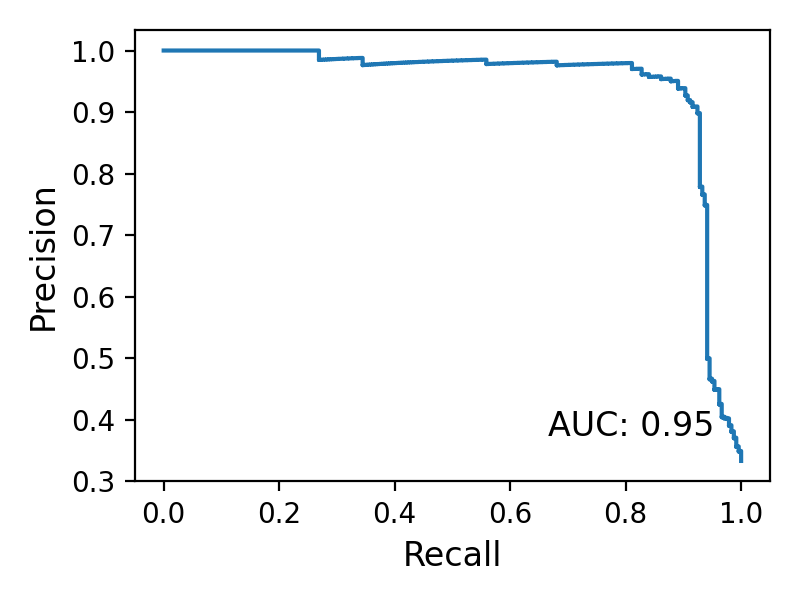

In [74]:
plot_pr_curve(precision_snp_based_rand, recall_snp_based_rand)

#### Negative set other AGs

In [65]:
canonical_introns_df = introns_overlapping_unique_start_1000_df[introns_overlapping_unique_start_1000_df.canonical_sites].copy().reset_index(drop=True)
donor_acceptor_ci = canonical_introns_df.apply(get_ags_donor_ci_avg_values, axis=1, sample_random_equidistant_ci_values=False)
donor_acceptor_ci

0      (0.9634805917739868, 1.1248853206634521, [2.97...
1      (0.2649269998073578, 0.4123517870903015, [0.11...
2      (2.275071620941162, 0.785906970500946, [0.1474...
3      (1.423882246017456, 0.9766368865966797, [0.536...
4      (0.49697333574295044, 1.0674617290496826, [0.2...
                             ...                        
117    (0.7715467214584351, 0.17814162373542786, [0.5...
118    (1.2974998950958252, 0.4421766400337219, [0.19...
119    (1.8340765237808228, 0.9628984332084656, [0.12...
120    (1.527732014656067, 1.8483558893203735, [0.786...
121    (0.40906399488449097, 0.7474406361579895, [0.4...
Length: 122, dtype: object

In [66]:
donor_acceptor_ci_df = pd.DataFrame(donor_acceptor_ci.to_list(), columns = ['donor_acceptor_ci_avg_values', 'acceptor_donors_ci_avg_values', 'non_can_ag_ci_values'])
donor_acceptor_ci_df

,donor_acceptor_ci_avg_values,acceptor_donors_ci_avg_values,non_can_ag_ci_values
0,0.963481,1.124885,"[2.9748659133911133, 0.48326653242111206, 0.33..."
1,0.264927,0.412352,"[0.11136839538812637, 0.1093689426779747, 0.15..."
2,2.275072,0.785907,"[0.1474660485982895, 0.1791108101606369, 0.154..."
3,1.423882,0.976637,"[0.5366183519363403, 0.340617299079895, 0.1259..."
4,0.496973,1.067462,"[0.28940895199775696, 0.10430319607257843]"
...,...,...,...
117,0.771547,0.178142,"[0.5870765447616577, 0.27322739362716675, 0.11..."
118,1.297500,0.442177,"[0.1971203088760376, 0.3016446530818939]"
119,1.834077,0.962898,[0.1233847588300705]
120,1.527732,1.848356,"[0.7866978049278259, 0.10046430677175522, 0.07..."


In [67]:
assert len(canonical_introns_df) == len(donor_acceptor_ci_df)
canonical_introns_df = pd.concat([canonical_introns_df, donor_acceptor_ci_df], axis=1)
canonical_introns_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix,intron_seq,AG_locations,canonical_branchpoint_location,donor_acceptor_ci_avg_values,acceptor_donors_ci_avg_values,non_can_ag_ci_values
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,644,639,533,531,GTAAGTACAGAAAGCCACAGAGTACCATCTAGGAAATTAACATTAT...,"[3, 8, 12, 18, 20, 30, 111]",45,0.963481,1.124885,"[2.9748659133911133, 0.48326653242111206, 0.33..."
1,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,196,201,322,324,GTATGTTCATAATGATTTACATCGGAATTCCCTTTGATACAAGAAA...,"[41, 79, 84, 126]",86,0.264927,0.412352,"[0.11136839538812637, 0.1093689426779747, 0.15..."
2,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,414,409,32,30,GTATGTTTAACAGTGATACTAAATTTTGAACCTTTCACAAGATTTA...,"[11, 39, 78, 80, 86, 91, 104, 111, 129, 136, 1...",337,2.275072,0.785907,"[0.1474660485982895, 0.1791108101606369, 0.154..."
3,YBL050W,intron,II,125154,125270,+,125154,125159,125268,125270,...,605,600,491,489,GTATGTAGTAGGGAAATATATCAAAGGAACAAAATGAAAGCTATGT...,"[6, 9, 24, 38, 63, 114]",71,1.423882,0.976637,"[0.5366183519363403, 0.340617299079895, 0.1259..."
4,YBL059W,intron,II,110879,110948,+,110879,110884,110946,110948,...,443,448,510,512,GTATGCATAGGCAATAACTTCGGCCTCATACTCAAAGAACACGTTT...,"[8, 35, 67]",45,0.496973,1.067462,"[0.28940895199775696, 0.10430319607257843]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117,YPL031C,intron,XVI,492918,493020,-,493015,493020,492918,492920,...,478,473,378,376,GTATGTAGTTTTCTAGTCAAGTATCATTGGAAAGTAAAGAACTAGA...,"[6, 14, 19, 32, 37, 43, 71, 88, 100]",55,0.771547,0.178142,"[0.5870765447616577, 0.27322739362716675, 0.11..."
118,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,143,148,293,295,GTTCGTATTTTACGCATGGATTAACGGTTTTAAAGAATAACATCAA...,"[33, 96, 150]",107,1.297500,0.442177,"[0.1971203088760376, 0.3016446530818939]"
119,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,329,324,245,243,GTATGTTTTTCACCGACAATTTTCTTTCAAATTTGCTGATATTGCC...,"[59, 84]",52,1.834077,0.962898,[0.1233847588300705]
120,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,691,686,597,595,GTATGTACAGATTAAGACACAAGAAAAAATTTGAACAATTATGATT...,"[8, 14, 21, 51, 94]",-1,1.527732,1.848356,"[0.7866978049278259, 0.10046430677175522, 0.07..."


In [68]:
non_can_ag_values = np.concatenate(donor_acceptor_ci_df['non_can_ag_ci_values'].dropna().values)

In [69]:
all_deps_df = pd.DataFrame({'dependency': np.concatenate([donor_acceptor_values, acceptor_donors_values, random_equidistant_values, non_can_ag_values]), 
                            'type': ['Donor-acceptor'] * len(donor_acceptor_values) + ['Donor-acceptor'] * len(acceptor_donors_values) + ['Matched\ndistance'] * len(random_equidistant_values) + ['Donor-decoy\nacceptor'] * len(non_can_ag_values)})
all_deps_df

,dependency,type
0,0.963481,Donor-acceptor
1,0.264927,Donor-acceptor
2,2.275072,Donor-acceptor
3,1.423882,Donor-acceptor
4,0.496973,Donor-acceptor
...,...,...
1592,0.481448,Donor-decoy\nacceptor
1593,0.136494,Donor-decoy\nacceptor
1594,0.316160,Donor-decoy\nacceptor
1595,0.094945,Donor-decoy\nacceptor


In [74]:
all_deps_df.to_csv(os.path.join(data_path, 'splicing_deps-s_cerevisiae.tsv'), sep='\t')

In [75]:
cowplot_theme = lambda figure_size, font_size: theme(
    # Set the background to white and remove panel border
    panel_background=element_blank(),
    panel_border=element_blank(),

    # Light grey grid lines
    panel_grid_major=element_line(color='lightgrey', size=0.5),
    panel_grid_minor=element_blank(),

    # Minimize axis ticks
    axis_ticks=element_blank(),

    # Simple font
    text=element_text(color='black'),
    axis_text=element_text(size=font_size),
    axis_title_y=element_text(size=font_size),
    figure_size = figure_size
    
    
)

In [88]:
donor_acceptor[~donor_acceptor.isna()]

0      0.963481
1      0.264927
2      2.275072
3      1.423882
4      0.496973
         ...   
239    0.178142
240    0.442177
241    0.962898
242    1.848356
243    0.747441
Name: dependency, Length: 238, dtype: float64

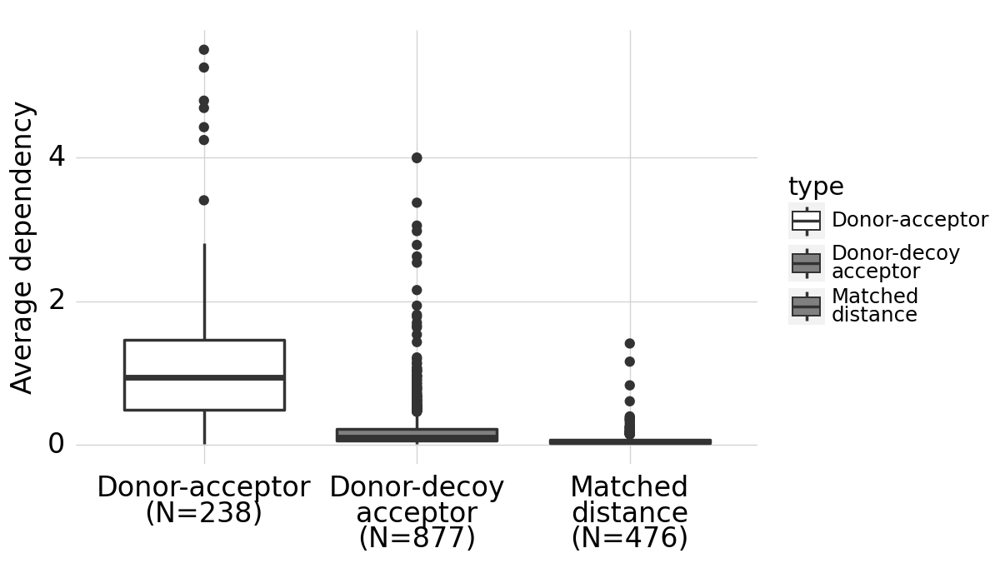

<Figure Size: (600 x 350)>

In [100]:
#plot boxplot
all_deps_df = all_deps_df.dropna()
counts = all_deps_df['type'].value_counts()
all_deps_df['type label'] = all_deps_df['type'].map(lambda x: f"{x}\n(N={counts[x]})")
p = (ggplot(all_deps_df, aes(x='type label', y='dependency', fill='type')) + geom_boxplot(size=.7) + 
     cowplot_theme(figure_size=(6, 3.5), font_size=12) + 
     labs(y='Average dependency', x='') +
     scale_fill_manual(values=['white', 'grey', 'grey']))
p

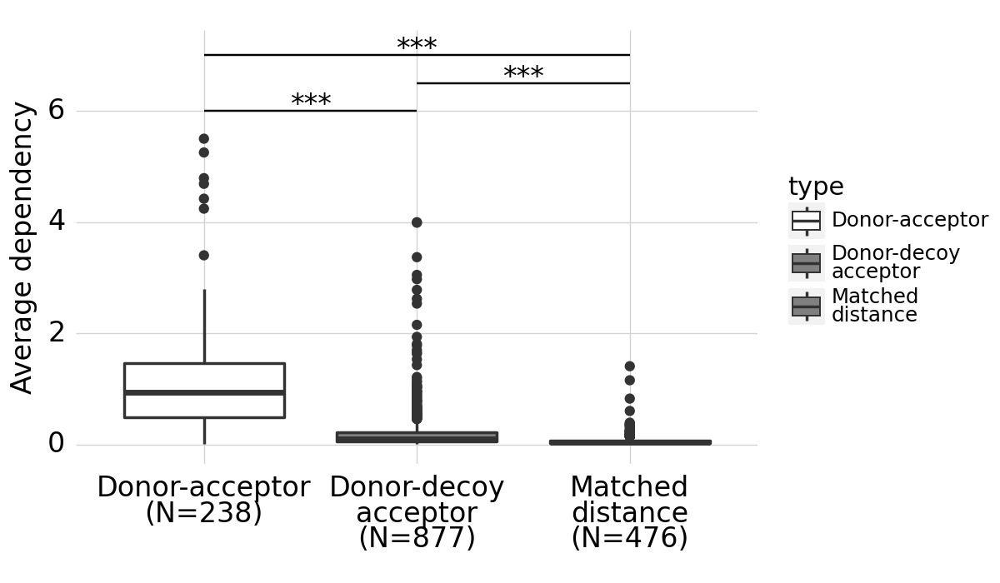

In [101]:
# Add annotations for significance

import pandas as pd
from scipy.stats import ranksums

def get_label(p):
    if p < 0.001:
        return '***'
    elif p < 0.01:
        return '**'
    elif p < 0.05:
        return '*'
    else:
        return 'ns'


# Assuming all_deps_df is your dataframe
donor_acceptor = all_deps_df[all_deps_df['type'] == 'Donor-acceptor']['dependency']
donor_decoy_acceptor = all_deps_df[all_deps_df['type'] == 'Donor-decoy\nacceptor']['dependency']
matched_distance = all_deps_df[all_deps_df['type'] == 'Matched\ndistance']['dependency']

# Perform the Wilcoxon rank-sum test
p1 = ranksums(donor_acceptor, donor_decoy_acceptor).pvalue
p2 = ranksums(donor_decoy_acceptor, matched_distance).pvalue
p3 = ranksums(donor_acceptor, matched_distance).pvalue

significance_levels = [(p1, 0, 1), (p2, 1, 2), (p3, 0, 2)]
labels = ['*', '**', '***']

y_max = max(all_deps_df['dependency'])
y_step = 0.5  # Adjust this value to control the spacing

for i, (p_value, x1, x2) in enumerate(significance_levels):
    label = get_label(p_value)
    y = y_max + (i + 1) * y_step
    y_pos = y + 0.1
    p = (p + 
         annotate('segment', x=x1 + 1, xend=x2 + 1, y=y, yend=y, color='black') +
         annotate('text', x=(x1 + x2) / 2 + 1, y=y_pos, label=label, ha='center', size=12))

# Show the plot
print(p)

In [102]:
ggsave(p, 'fig3_splicing_s_cerevisiae_boxplots.png', dpi=500)

/opt/modules/i12g/anaconda/envs/fungi_code/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6 x 3.5 in image.
/opt/modules/i12g/anaconda/envs/fungi_code/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /s/project/multispecies/fungi_code/ci_matrices/dna-lm-interactions-paper/figures/fig3_splicing_s_cerevisiae_boxplots.png


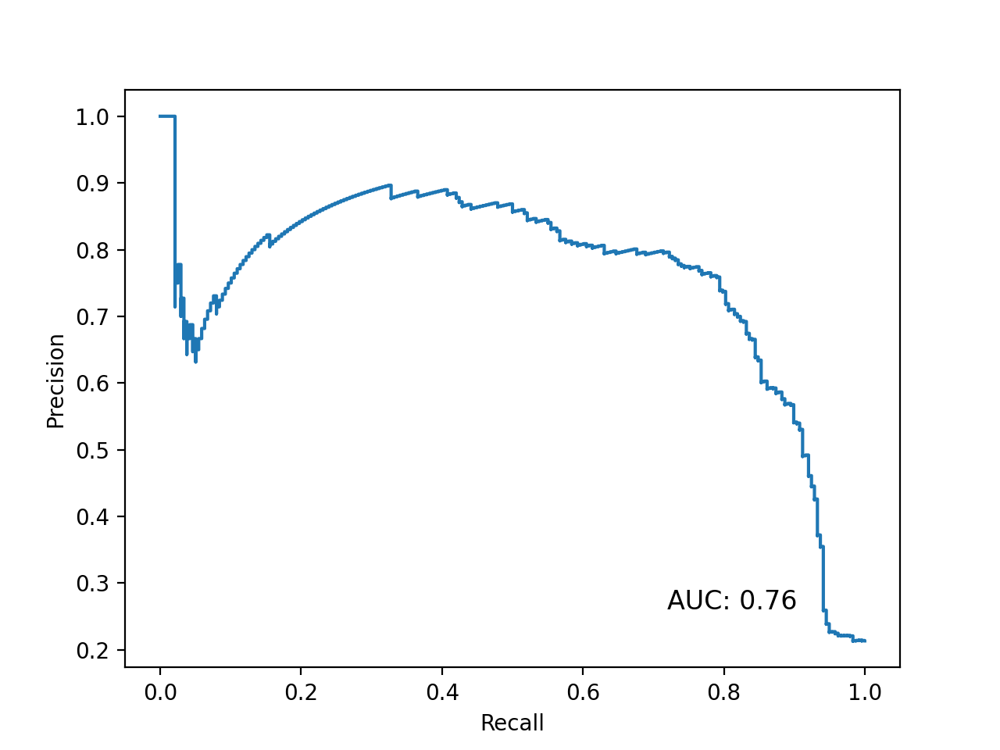

In [98]:
donor_acceptor_values = donor_acceptor_ci_df['donor_acceptor_ci_avg_values'].values
acceptor_donors_values = donor_acceptor_ci_df['acceptor_donors_ci_avg_values'].values

precision_snp_based_ags, recall_snp_based_ags, len_pos_snp_based_ags, len_neg_snp_based_ags = get_pr_values(donor_acceptor_values, acceptor_donors_values, negative_set='non_can_ags')

plot_pr_curve(precision_snp_based_ags, recall_snp_based_ags)

#### Gradient based

In [95]:
gene_id_to_transcript_id = pr.read_gtf(gtf_path).df[['gene_id', 'transcript_id']].drop_duplicates().dropna().reset_index(drop=True)
id_to_path = pd.read_parquet(os.path.join(data_path, f"samples_upstream_kazachstania_k1_grads/{species_of_interest}/id_to_path.parquet"))
id_to_path = id_to_path.merge(gene_id_to_transcript_id, on='transcript_id')

all_genes = list(id_to_path['gene_id'].unique())

def get_ci_matrix(gene_id=None, id_to_path_grads=id_to_path, transcript_id=None, correct_gradients=False, reorder=True):

    if not transcript_id:
        # subset snp df
        subset_df = id_to_path_grads.query('gene_id == "{}"'.format(gene_id))#.iloc[0]["path"]
        # take first transcript
        transcript_id = subset_df.iloc[0]["transcript_id"]
        subset_df = subset_df.query('transcript_id == "{}"'.format(transcript_id))
    else:
        subset_df = id_to_path_grads.query('transcript_id == "{}"'.format(transcript_id))

    if len(subset_df) == 0:
        return None
    # get path and indices
    path = subset_df.iloc[0]["path"].replace("nuc_preds","nuc_grads") ## FIXME
    idx_in_file = subset_df.iloc[0]["idx_in_file"]
    # load gradients
    grads = torch.load(path).float()
    grads = grads[idx_in_file] # output --> 1003,4,4,1003 <-- variant
    # reorder
    grads = grads.permute(2,3,0,1) # variant --> 4,1003,1003,4 <-- output
    # Note: this is in BERT-order (ATCG), not standard one-hot order (ACGT)
    if reorder:
        g_reord_col = torch.zeros_like(grads)
        for mapping in [(0,0),(1,2),(2,3),(3,1)]:
            g_reord_col[:,:,:,mapping[0]] = grads[:,:,:,mapping[1]]
        g_reord = torch.zeros_like(g_reord_col)
        for mapping in [(0,0),(1,2),(2,3),(3,1)]:
            g_reord[mapping[0],:,:,:] = g_reord_col[mapping[1],:,:,:]
        grads = g_reord
    if correct_gradients:
        # remove average over possible variant nucleotides
        grads = grads - grads.mean(axis=0,keepdims=True)

    grads = torch.abs(grads).max(dim=0)[0].max(dim=2)[0] # get the maximum absolute value over the 4x4 nuc possibilities per position
    return grads

tensor([[0.0559, 0.0536],
        [0.0142, 0.0150],
        [0.0607, 0.0553],
        [0.0458, 0.0431],
        [0.0083, 0.0071]])
tensor([[0.0108, 0.0086, 0.0068, 0.0052, 0.0084],
        [0.0176, 0.0158, 0.0076, 0.0051, 0.0069]])


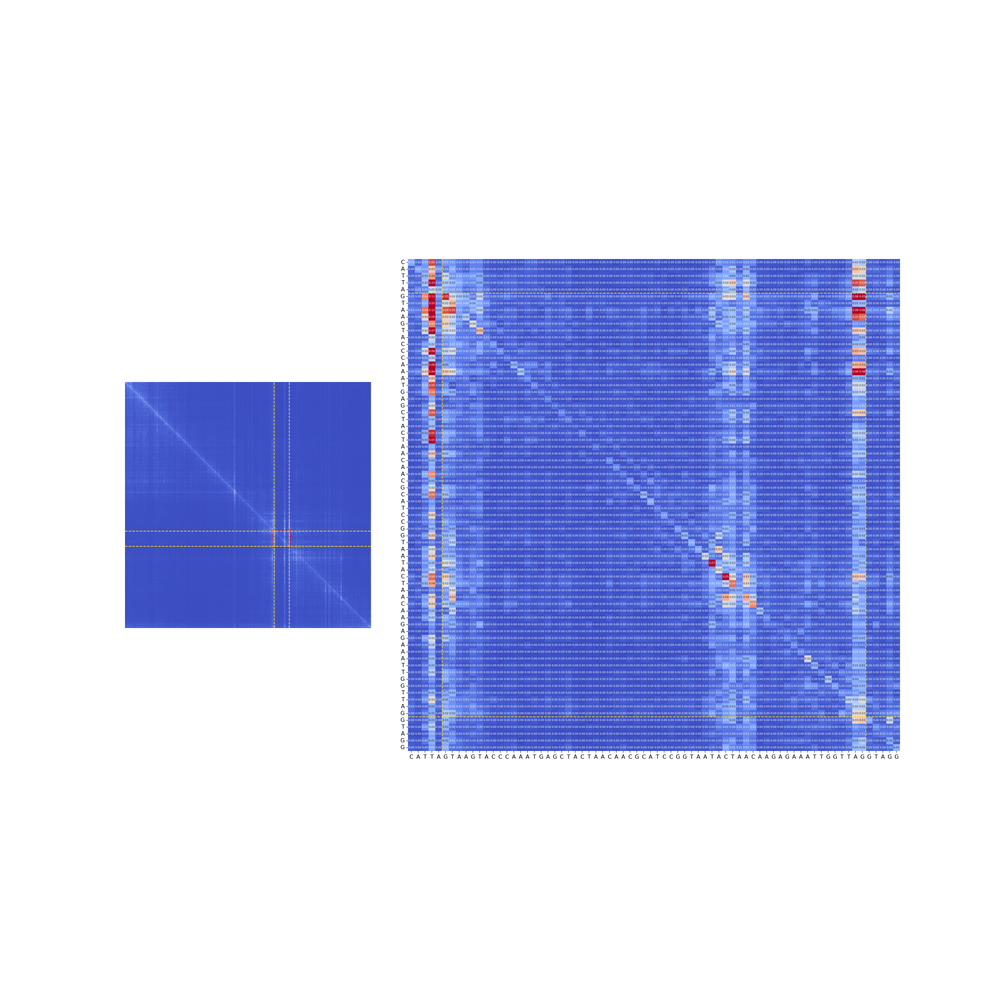

In [96]:
transcript = 'YIL156W_mRNA'
get_ags_donor_ci_avg_values(canonical_introns_df[canonical_introns_df.transcript_id == transcript].iloc[0], print_values=True)
plot_splice_sites_w_matrix(transcript_id=transcript, display_values=True, annot_size=6, zoom_slack=5, vmax=.05)

In [97]:
canonical_introns_df = introns_overlapping_unique_start_1000_df[introns_overlapping_unique_start_1000_df.canonical_sites].copy().reset_index(drop=True)
donor_acceptor_ci = canonical_introns_df.apply(get_ags_donor_ci_avg_values, axis=1, sample_random_equidistant_ci_values=True,  num_samples=4)
donor_acceptor_ci

0      (0.006944245658814907, 0.004489474929869175, [...
1      (0.01097328495234251, 0.0038709226064383984, [...
2      (0.019347021356225014, 0.008245300501585007, [...
3      (0.02956678904592991, 0.008899269625544548, [0...
4      (0.0069892569445073605, 0.0029142643325030804,...
                             ...                        
117    (0.022127334028482437, 0.002650575013831258, [...
118    (0.03175758197903633, 0.011679594404995441, [0...
119    (0.007169540040194988, 0.0027447794564068317, ...
120    (0.021924953907728195, 0.007459132466465235, [...
121    (0.01072362344712019, 0.026131082326173782, [0...
Length: 122, dtype: object

In [98]:
donor_acceptor_ci_df = pd.DataFrame(donor_acceptor_ci.to_list(), columns = ['donor_acceptor_ci_avg_values', 'acceptor_donors_ci_avg_values', 'random_ci_values'])
donor_acceptor_ci_df

,donor_acceptor_ci_avg_values,acceptor_donors_ci_avg_values,random_ci_values
0,0.006944,0.004489,"[0.0011168401688337326, 0.0013058672193437815,..."
1,0.010973,0.003871,"[0.0005276609444990754, 0.000304310058709234, ..."
2,0.019347,0.008245,"[0.0004106360429432243, 0.0003875000402331352,..."
3,0.029567,0.008899,"[0.0003405785537324846, 0.00026773993158712983..."
4,0.006989,0.002914,"[0.0007113670581020415, 0.0004704154562205076,..."
...,...,...,...
117,0.022127,0.002651,"[0.0005606868071481586, 0.0026314815040677786,..."
118,0.031758,0.011680,"[0.022123977541923523, 0.010947144590318203, 0..."
119,0.007170,0.002745,"[0.0004062540247105062, 0.00038181437412276864..."
120,0.021925,0.007459,"[0.0005461619584821165, 0.0014532746281474829,..."


In [99]:
assert len(canonical_introns_df) == len(donor_acceptor_ci_df)
canonical_introns_df = pd.concat([canonical_introns_df, donor_acceptor_ci_df], axis=1)
canonical_introns_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix,intron_seq,AG_locations,canonical_branchpoint_location,donor_acceptor_ci_avg_values,acceptor_donors_ci_avg_values,random_ci_values
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,644,639,533,531,GTAAGTACAGAAAGCCACAGAGTACCATCTAGGAAATTAACATTAT...,"[3, 8, 12, 18, 20, 30, 111]",45,0.006944,0.004489,"[0.0011168401688337326, 0.0013058672193437815,..."
1,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,196,201,322,324,GTATGTTCATAATGATTTACATCGGAATTCCCTTTGATACAAGAAA...,"[41, 79, 84, 126]",86,0.010973,0.003871,"[0.0005276609444990754, 0.000304310058709234, ..."
2,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,414,409,32,30,GTATGTTTAACAGTGATACTAAATTTTGAACCTTTCACAAGATTTA...,"[11, 39, 78, 80, 86, 91, 104, 111, 129, 136, 1...",337,0.019347,0.008245,"[0.0004106360429432243, 0.0003875000402331352,..."
3,YBL050W,intron,II,125154,125270,+,125154,125159,125268,125270,...,605,600,491,489,GTATGTAGTAGGGAAATATATCAAAGGAACAAAATGAAAGCTATGT...,"[6, 9, 24, 38, 63, 114]",71,0.029567,0.008899,"[0.0003405785537324846, 0.00026773993158712983..."
4,YBL059W,intron,II,110879,110948,+,110879,110884,110946,110948,...,443,448,510,512,GTATGCATAGGCAATAACTTCGGCCTCATACTCAAAGAACACGTTT...,"[8, 35, 67]",45,0.006989,0.002914,"[0.0007113670581020415, 0.0004704154562205076,..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117,YPL031C,intron,XVI,492918,493020,-,493015,493020,492918,492920,...,478,473,378,376,GTATGTAGTTTTCTAGTCAAGTATCATTGGAAAGTAAAGAACTAGA...,"[6, 14, 19, 32, 37, 43, 71, 88, 100]",55,0.022127,0.002651,"[0.0005606868071481586, 0.0026314815040677786,..."
118,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,143,148,293,295,GTTCGTATTTTACGCATGGATTAACGGTTTTAAAGAATAACATCAA...,"[33, 96, 150]",107,0.031758,0.011680,"[0.022123977541923523, 0.010947144590318203, 0..."
119,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,329,324,245,243,GTATGTTTTTCACCGACAATTTTCTTTCAAATTTGCTGATATTGCC...,"[59, 84]",52,0.007170,0.002745,"[0.0004062540247105062, 0.00038181437412276864..."
120,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,691,686,597,595,GTATGTACAGATTAAGACACAAGAAAAAATTTGAACAATTATGATT...,"[8, 14, 21, 51, 94]",-1,0.021925,0.007459,"[0.0005461619584821165, 0.0014532746281474829,..."


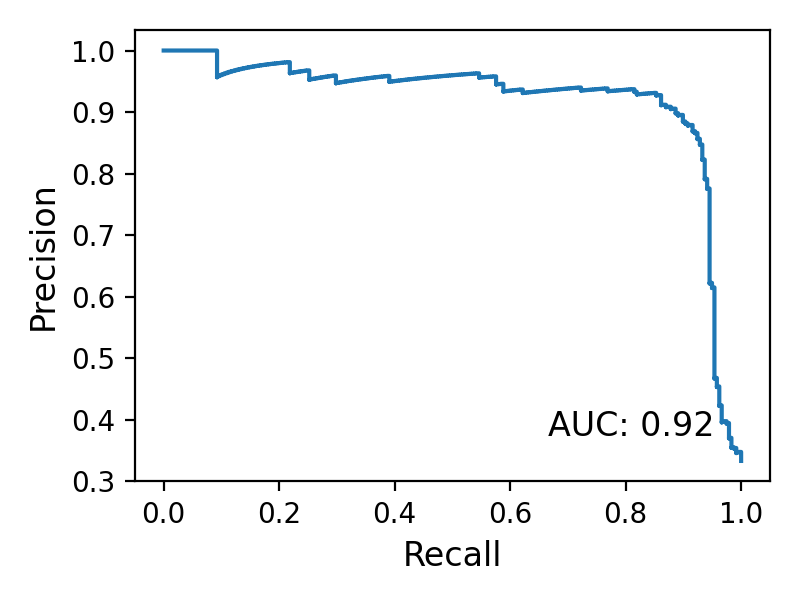

In [100]:
donor_acceptor_values = donor_acceptor_ci_df['donor_acceptor_ci_avg_values'].values
acceptor_donors_values = donor_acceptor_ci_df['acceptor_donors_ci_avg_values'].values

precision_grad_based_rand, recall_grad_based_rand, len_pos_grad_based_rand, len_neg_grad_based_rand = get_pr_values(donor_acceptor_values, acceptor_donors_values, negative_set='random')

plot_pr_curve(precision_grad_based_rand, recall_grad_based_rand)

#### Masking based

In [103]:
snp_df.transcript_id.unique()

array(['YAL037W_mRNA', 'YAL016W_mRNA', 'YAL003W_mRNA', ...,
       'YPR179C_mRNA', 'YPR096C_mRNA', 'YPL174C_mRNA'], dtype=object)

In [ ]:
real_seqs_df = pd.read_csv(os.path.join(data_path, f'Saccharomyces_cerevisiae_BY4741_upstream_1000bp_with_start_cds_downstream_509bp_with_stop_longest_cds.tsv'), sep='\t')

matrices_path_species = os.path.join(data_path, 'Saccharomyces_cerevisiae_BY4741_k1_model_mask_based')

print(f'Loading stored gene id ci matrices from {matrices_path_species}...')

#create a dict with the file names and the file paths
genes_to_files = {f.split('.npy')[0]: os.path.join(matrices_path_species, f) for f in os.listdir(matrices_path_species)}
#all_genes = list(genes_to_files.keys())

def get_ci_matrix(transcript_id):
    if transcript_id in snp_df.transcript_id.unique(): #only get transcripts if they are also in the previous methods. Currently this dataset was computed with not exactly the same number of transcripts. Can be fixed later on but won't influence results as we take the intersection and we assert that later on
        gene_id = real_seqs_df[real_seqs_df.transcript_id == transcript_id].gene_id.values[0]
        if gene_id in genes_to_files:
            return torch.tensor(np.load(genes_to_files[gene_id])).to(torch.float32)
        else:
            return None

tensor([[1.1197, 0.9844],
        [1.0274, 1.0032],
        [0.5343, 0.5430],
        [0.3739, 0.3464],
        [0.5895, 0.6692]])
tensor([[0.9837, 1.1401, 0.1160, 0.2562, 0.3053],
        [0.7334, 0.7945, 0.1522, 0.1998, 0.1726]])


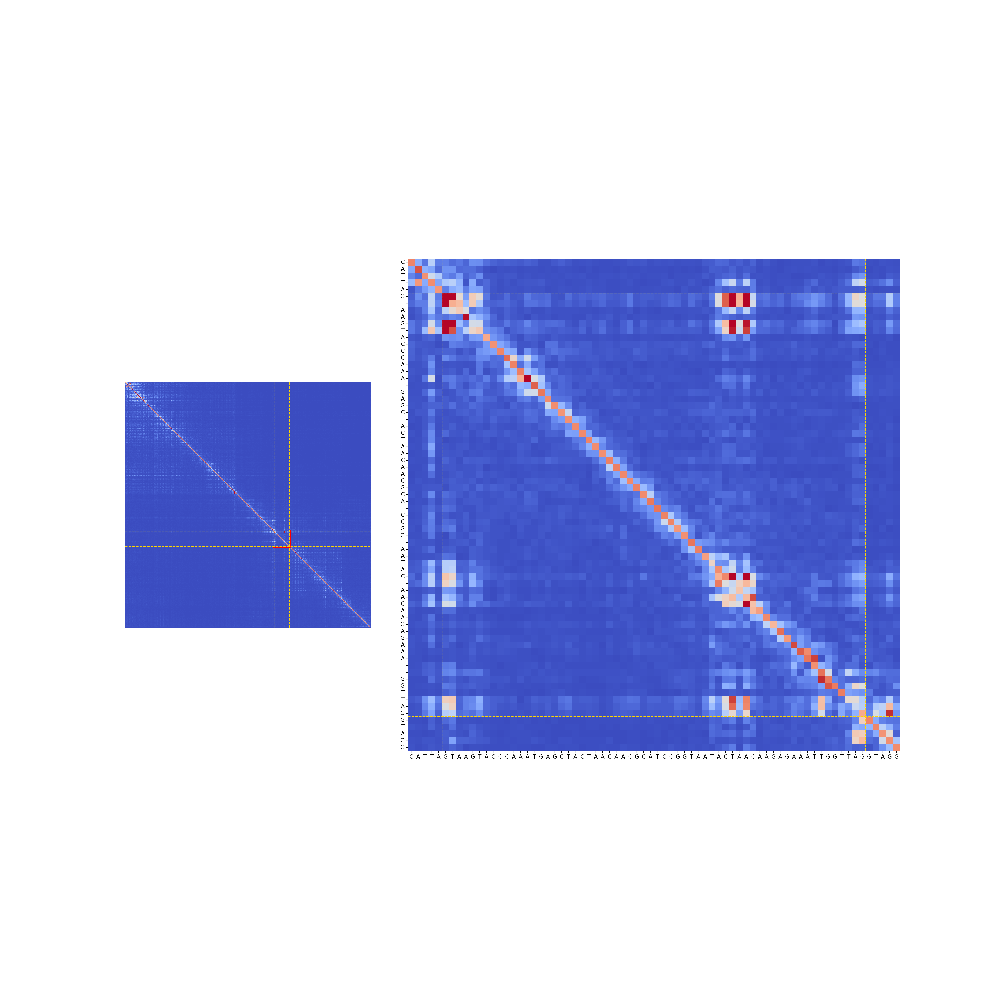

In [105]:
transcript = 'YIL156W_mRNA'
get_ags_donor_ci_avg_values(canonical_introns_df[canonical_introns_df.transcript_id == transcript].iloc[0], print_values=True)
plot_splice_sites_w_matrix(transcript_id =transcript ,  annot_size=6, zoom_slack=5, vmax=2)

In [106]:
canonical_introns_df = introns_overlapping_unique_start_1000_df[introns_overlapping_unique_start_1000_df.canonical_sites].copy().reset_index(drop=True)
donor_acceptor_ci = canonical_introns_df.apply(get_ags_donor_ci_avg_values, axis=1, sample_random_equidistant_ci_values=True,  num_samples=4)
donor_acceptor_ci

0      (0.1016378253698349, 0.31737956404685974, [0.0...
1      (0.21464578807353973, 0.16583946347236633, [0....
2      (0.8033710718154907, 0.253862202167511, [0.004...
3      (0.4273884892463684, 0.46743878722190857, [0.0...
4      (0.14060363173484802, 0.2079908400774002, [0.0...
                             ...                        
117    (0.1977594792842865, 0.08751620352268219, [0.0...
118    (0.7396062016487122, 0.29284197092056274, [0.4...
119    (0.6960185766220093, 0.1155833825469017, [0.01...
120    (0.4194488525390625, 0.3460328280925751, [0.01...
121    (0.3002799153327942, 0.18678171932697296, [0.0...
Length: 122, dtype: object

In [107]:
donor_acceptor_ci_df = pd.DataFrame(donor_acceptor_ci.to_list(), columns = ['donor_acceptor_ci_avg_values', 'acceptor_donors_ci_avg_values', 'random_ci_values'])
donor_acceptor_ci_df

,donor_acceptor_ci_avg_values,acceptor_donors_ci_avg_values,random_ci_values
0,0.101638,0.317380,"[0.01350327767431736, 0.014857172966003418, 0...."
1,0.214646,0.165839,"[0.009882553480565548, 0.010134958662092686, 0..."
2,0.803371,0.253862,"[0.0040648807771503925, 0.00552994292229414, 0..."
3,0.427388,0.467439,"[0.007802682463079691, 0.004030955024063587, 0..."
4,0.140604,0.207991,"[0.018653331324458122, 0.020459506660699844, 0..."
...,...,...,...
117,0.197759,0.087516,"[0.016751404851675034, 0.10668782889842987, 0...."
118,0.739606,0.292842,"[0.4997999668121338, 0.06348804384469986, 0.04..."
119,0.696019,0.115583,"[0.012499235570430756, 0.013657411560416222, 0..."
120,0.419449,0.346033,"[0.016662925481796265, 0.01471987646073103, 0...."


In [108]:
assert len(canonical_introns_df) == len(donor_acceptor_ci_df)
canonical_introns_df = pd.concat([canonical_introns_df, donor_acceptor_ci_df], axis=1)
canonical_introns_df

,intron_gene_id,Feature,Chromosome,Start,End,Strand,donor_start,donor_end,acceptor_start,acceptor_end,...,donor_rel_start_matrix,donor_rel_end_matrix,acceptor_rel_start_matrix,acceptor_rel_end_matrix,intron_seq,AG_locations,canonical_branchpoint_location,donor_acceptor_ci_avg_values,acceptor_donors_ci_avg_values,random_ci_values
0,YAL030W,intron,I,87387,87500,+,87387,87392,87498,87500,...,644,639,533,531,GTAAGTACAGAAAGCCACAGAGTACCATCTAGGAAATTAACATTAT...,"[3, 8, 12, 18, 20, 30, 111]",45,0.101638,0.317380,"[0.01350327767431736, 0.014857172966003418, 0...."
1,YBL026W,intron,II,170676,170804,+,170676,170681,170802,170804,...,196,201,322,324,GTATGTTCATAATGATTTACATCGGAATTCCCTTTGATACAAGAAA...,"[41, 79, 84, 126]",86,0.214646,0.165839,"[0.009882553480565548, 0.010134958662092686, 0..."
2,YBL027W,intron,II,168424,168808,+,168424,168429,168806,168808,...,414,409,32,30,GTATGTTTAACAGTGATACTAAATTTTGAACCTTTCACAAGATTTA...,"[11, 39, 78, 80, 86, 91, 104, 111, 129, 136, 1...",337,0.803371,0.253862,"[0.0040648807771503925, 0.00552994292229414, 0..."
3,YBL050W,intron,II,125154,125270,+,125154,125159,125268,125270,...,605,600,491,489,GTATGTAGTAGGGAAATATATCAAAGGAACAAAATGAAAGCTATGT...,"[6, 9, 24, 38, 63, 114]",71,0.427388,0.467439,"[0.007802682463079691, 0.004030955024063587, 0..."
4,YBL059W,intron,II,110879,110948,+,110879,110884,110946,110948,...,443,448,510,512,GTATGCATAGGCAATAACTTCGGCCTCATACTCAAAGAACACGTTT...,"[8, 35, 67]",45,0.140604,0.207991,"[0.018653331324458122, 0.020459506660699844, 0..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117,YPL031C,intron,XVI,492918,493020,-,493015,493020,492918,492920,...,478,473,378,376,GTATGTAGTTTTCTAGTCAAGTATCATTGGAAAGTAAAGAACTAGA...,"[6, 14, 19, 32, 37, 43, 71, 88, 100]",55,0.197759,0.087516,"[0.016751404851675034, 0.10668782889842987, 0...."
118,YPL109C,intron,XVI,345444,345596,-,345591,345596,345444,345446,...,143,148,293,295,GTTCGTATTTTACGCATGGATTAACGGTTTTAAAGAATAACATCAA...,"[33, 96, 150]",107,0.739606,0.292842,"[0.4997999668121338, 0.06348804384469986, 0.04..."
119,YPR063C,intron,XVI,678193,678279,-,678274,678279,678193,678195,...,329,324,245,243,GTATGTTTTTCACCGACAATTTTCTTTCAAATTTGCTGATATTGCC...,"[59, 84]",52,0.696019,0.115583,"[0.012499235570430756, 0.013657411560416222, 0..."
120,YPR098C,intron,XVI,729385,729481,-,729476,729481,729385,729387,...,691,686,597,595,GTATGTACAGATTAAGACACAAGAAAAAATTTGAACAATTATGATT...,"[8, 14, 21, 51, 94]",-1,0.419449,0.346033,"[0.016662925481796265, 0.01471987646073103, 0...."


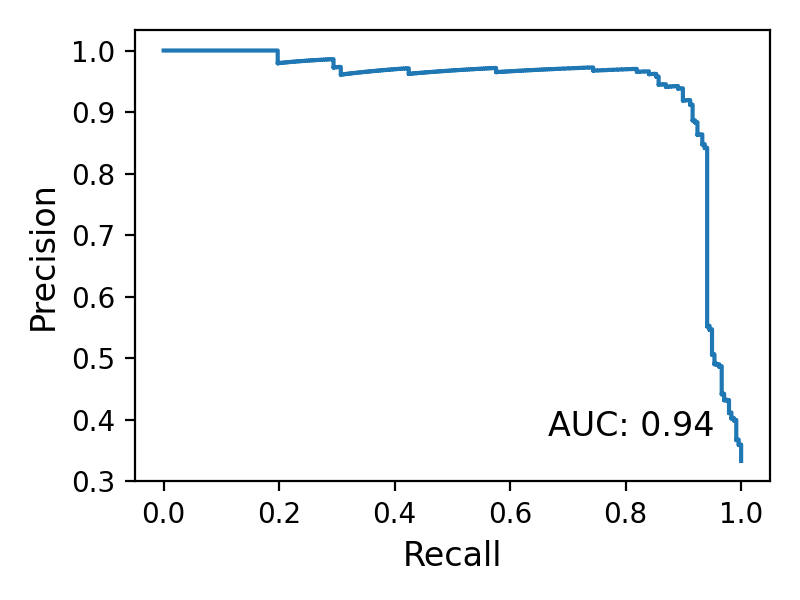

In [109]:
donor_acceptor_values = donor_acceptor_ci_df['donor_acceptor_ci_avg_values'].values
acceptor_donors_values = donor_acceptor_ci_df['acceptor_donors_ci_avg_values'].values

precision_mask_based_rand, recall_mask_based_rand, len_pos_mask_based_rand, len_neg_mask_based_rand = get_pr_values(donor_acceptor_values, acceptor_donors_values, negative_set='random')

plot_pr_curve(precision_mask_based_rand, recall_mask_based_rand)

## All methods comparison

In [111]:
#assert lengths of positive and negative sets for the different methods are the same

assert len_pos_snp_based_rand == len_pos_grad_based_rand == len_pos_mask_based_rand
assert len_neg_snp_based_rand == len_neg_grad_based_rand == len_neg_mask_based_rand

In [114]:
pr_df = pd.DataFrame({'precision_grad':precision_grad_based_rand, 
                      'precision_mask':precision_mask_based_rand, 
                      'precision_subs':precision_snp_based_rand,
                      'recall_grad':recall_grad_based_rand, 
                      'recall_mask':recall_mask_based_rand, 
                      'recall_subs':recall_snp_based_rand})
pr_df

,precision_grad,precision_mask,precision_subs,recall_grad,recall_mask,recall_subs
0,0.333333,0.333333,0.333333,1.000000,1.000000,1.000000
1,0.333801,0.333801,0.333801,1.000000,1.000000,1.000000
2,0.334270,0.334270,0.334270,1.000000,1.000000,1.000000
3,0.334740,0.334740,0.334740,1.000000,1.000000,1.000000
4,0.335211,0.335211,0.335211,1.000000,1.000000,1.000000
...,...,...,...,...,...,...
710,1.000000,1.000000,1.000000,0.016807,0.016807,0.016807
711,1.000000,1.000000,1.000000,0.012605,0.012605,0.012605
712,1.000000,1.000000,1.000000,0.008403,0.008403,0.008403
713,1.000000,1.000000,1.000000,0.004202,0.004202,0.004202


In [116]:
pr_df.to_csv(os.path.join(data_path, 'splicing_dep_metrics.csv'), sep='\t')

In [8]:
recall_snp_based_rand = pr_df['recall_subs'].values
recall_mask_based_rand = pr_df['recall_mask'].values
recall_grad_based_rand = pr_df['recall_grad'].values

precision_snp_based_rand = pr_df['precision_subs'].values
precision_mask_based_rand = pr_df['precision_mask'].values
precision_grad_based_rand = pr_df['precision_grad'].values

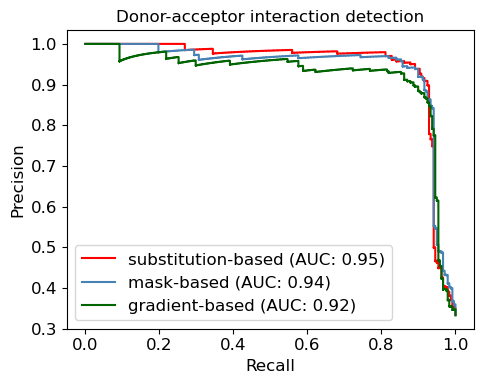

In [10]:
from sklearn.metrics import precision_recall_curve,auc

# compare all methods with 3 precision recall curves for the rand negative set
# Set global font size
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(5, 4)) 
#show the auc in the label of each curve
colors = ['red', 'steelblue', 'darkgreen']  # Dark orange
plt.step(recall_snp_based_rand, precision_snp_based_rand, where='post', label=f'substitution-based (AUC: {auc(recall_snp_based_rand, precision_snp_based_rand):.2f})', color=colors[0])
plt.step(recall_mask_based_rand, precision_mask_based_rand, where='post', label=f'mask-based (AUC: {auc(recall_mask_based_rand, precision_mask_based_rand):.2f})', color=colors[1])
plt.step(recall_grad_based_rand, precision_grad_based_rand, where='post', label=f'gradient-based (AUC: {auc(recall_grad_based_rand, precision_grad_based_rand):.2f})', color=colors[2])



plt.title('Donor-acceptor interaction detection', fontsize=12)
plt.xlabel('Recall', fontsize=12)
plt.ylabel('Precision', fontsize=12)

# Adjust legend font size
plt.legend(fontsize=12)

# Adjust tick parameters font size
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.tight_layout()
plt.savefig('fig1_de_metrics_splicing.png', dpi=500)
plt.show()